### Pipe
- предобработка
    - разобраться в датасете что к чему относится
        - crowd это челики которые озвучивали текст так как им берт сказал вот да, а потом другие челики верно угадали эту озвуку
        - podcast это из аудиозаписей челики определяли эмоции
        - что такое test train в душе не ебу
        - 1 позитив 2 грусть 3 злость 4 нейтраль 5 непонятно
        - ***golden emo- эмоция контрольного задания хз че это значит; ***speaker_emo — эмоция, которую выражал диктор («заказанная» эмоция для разметчика-диктора из первой группы для семплов из Crowd, None для семплов из Podcasts);***annotator_emo — эмоция, которую указал разметчик;
    - склеить тест и трейн понятиь вообще что на чем там будет обучатсья ок да
        - было склеено в результате получили общий датасет с карудом и подкастом, в котором есть все эмоциональные метки и полловина нейтральных взятых случайно
    - провести визуализацию поправить графики
        - проверили в основном на количество записей и их длину
    - как вообще можно предобработать звук глянуть хотя бы 2-3 варианта понять че гуд а че не оч гуд
        - расписали несколько признаков какие могут использоваться для звука
    - предобработать и разбить на этапы че где будем обучать
- посмотреть какие модели есть и понять че будем обучать на каких моделях ну и списочек из на сгеодня все

In [1]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import random as rnd
import os
from  IPython.display import Audio
from librosa import display
import librosa
import numpy as np
from scipy.io.wavfile import read as read_wav
import sklearn
import soundfile as sf
import scipy
import csv
from sklearn import preprocessing
from sklearn.metrics import accuracy_score
from sklearn.metrics import f1_score
from joblib import parallel_backend
import cupy as xp
import time
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, TensorDataset
from sklearn.model_selection import train_test_split
from sklearn.metrics import precision_score, recall_score
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from sklearn.model_selection import GridSearchCV
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
import catboost

os.chdir(r'C:\Users\777\Documents\dusha')
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

C:\Users\777\anaconda3\lib\site-packages\cupy\_environment.py:487: UserWarning: 
--------------------------------------------------------------------------------

  CuPy may not function correctly because multiple CuPy packages are installed
  in your environment:

    cupy-cuda11x, cupy-cuda12x

  Follow these steps to resolve this issue:

    1. For all packages listed above, run the following command to remove all
       existing CuPy installations:

         $ pip uninstall <package_name>

      If you previously installed CuPy via conda, also run the following:

         $ conda uninstall cupy

    2. Install the appropriate CuPy package.
       Refer to the Installation Guide for detailed instructions.

         https://docs.cupy.dev/en/stable/install.html

--------------------------------------------------------------------------------

  warnings.warn(f'''


cuda


In [2]:
podcast_train=pd.read_csv('DATASET_PATH/podcast_train/raw_podcast_train.tsv',sep='\t')

In [3]:
podcast_train

,hash_id,audio_path,duration,annotator_emo,golden_emo,annotator_id,speaker_text,speaker_emo,source_id
0,857b7099a4f5766105d166e2283066fa,wavs/857b7099a4f5766105d166e2283066fa.wav,4.400000,neutral,NaN,a6aea16a81aa926eee405c0878162c91,NaN,NaN,d6738a1e0d59f783987e0503ddb4ca54
1,2107b749055d85d7c09ac49fd30e3feb,wavs/2107b749055d85d7c09ac49fd30e3feb.wav,3.800000,neutral,2.0,a6aea16a81aa926eee405c0878162c91,NaN,NaN,1fcfcacf584841d22fbdf4a51fe6177d
2,700b3a5644a0824831848c346d11c7d6,wavs/700b3a5644a0824831848c346d11c7d6.wav,2.500000,neutral,NaN,a6aea16a81aa926eee405c0878162c91,NaN,NaN,dfd63e80a7aca8d4cb4e14e062441886
3,e8c053899135f139e9527c1388790e36,wavs/e8c053899135f139e9527c1388790e36.wav,1.700000,neutral,NaN,a6aea16a81aa926eee405c0878162c91,NaN,NaN,63c3ae005d1663de92314be4377a8805
4,7fe59996e0f93b8a63e28aacf480004b,wavs/7fe59996e0f93b8a63e28aacf480004b.wav,1.900000,neutral,NaN,a6aea16a81aa926eee405c0878162c91,NaN,NaN,14abbe44c78118171f01348f862698cd
...,...,...,...,...,...,...,...,...,...
645808,0415f5c556f6588702641ebae32a698a,wavs/0415f5c556f6588702641ebae32a698a.wav,3.600000,neutral,NaN,80ec049b794f14870639a255b59c3078,NaN,NaN,9bccd32eaf59ee732b84672dadfbb15a
645809,35e8c579de45045fa81376d89dd8877d,wavs/35e8c579de45045fa81376d89dd8877d.wav,4.800000,neutral,NaN,80ec049b794f14870639a255b59c3078,NaN,NaN,6f904986003bce28ebe148edfcdb7f33
645810,c75e9fa9f8dfca88dc93fa1e60a82144,wavs/c75e9fa9f8dfca88dc93fa1e60a82144.wav,4.300000,neutral,NaN,80ec049b794f14870639a255b59c3078,NaN,NaN,fcc2fbbe281a7e75da02713d2fa2574f
645811,a82d82a9e4c970dfd8dd483ef603fca4,wavs/a82d82a9e4c970dfd8dd483ef603fca4.wav,3.300000,neutral,NaN,80ec049b794f14870639a255b59c3078,NaN,NaN,61f3be77ba1fbf6cef881af24c137923


In [4]:
podcast_test=pd.read_csv('DATASET_PATH/podcast_test/raw_podcast_test.tsv',sep='\t')

In [20]:
podcast_test

,hash_id,audio_path,duration,annotator_emo,golden_emo,annotator_id,speaker_text,speaker_emo,source_id
0,9749f1633078b5e2dfffbf0d3594a810,wavs/9749f1633078b5e2dfffbf0d3594a810.wav,3.000000,neutral,NaN,a6aea16a81aa926eee405c0878162c91,NaN,NaN,cf2b88351856b5aafe71a53d97c67fdb
1,92769fa87a3740ab9f398b6835b3b774,wavs/92769fa87a3740ab9f398b6835b3b774.wav,3.600125,neutral,NaN,a6aea16a81aa926eee405c0878162c91,NaN,NaN,d0fc37a2c3b3f3ae2c8f52ef7982cfdb
2,e5ccdbca2da61e1f517facf393fa9f95,wavs/e5ccdbca2da61e1f517facf393fa9f95.wav,2.000000,neutral,NaN,a6aea16a81aa926eee405c0878162c91,NaN,NaN,90811511e78c4adce8f508e3f7ae1a59
3,9b3a93ef2dd4a72e6952a4f84f38ca54,wavs/9b3a93ef2dd4a72e6952a4f84f38ca54.wav,2.400000,neutral,NaN,a6aea16a81aa926eee405c0878162c91,NaN,NaN,2f61a6bb38c301b1a412604b0600d1ea
4,92769fa87a3740ab9f398b6835b3b774,wavs/92769fa87a3740ab9f398b6835b3b774.wav,3.600125,neutral,NaN,8fda35910f15bcac6a8feef8498acf21,NaN,NaN,d0fc37a2c3b3f3ae2c8f52ef7982cfdb
...,...,...,...,...,...,...,...,...,...
83442,df4810512d0d63439f861241ef481271,wavs/df4810512d0d63439f861241ef481271.wav,2.700000,positive,NaN,9f6bd74348e0862d03fee7d5a8b2fafb,NaN,NaN,f7f6c3fa12c2353d6bdffff91ffd6a47
83443,884e90bb8fbd0930f01fd50dc03b1e3e,wavs/884e90bb8fbd0930f01fd50dc03b1e3e.wav,3.299875,neutral,NaN,9f6bd74348e0862d03fee7d5a8b2fafb,NaN,NaN,74116e4a24a654a39ffb63900a06ae99
83444,d7aa8f87606b8acf9f94e04a75eb6d19,wavs/d7aa8f87606b8acf9f94e04a75eb6d19.wav,2.400000,neutral,2.0,9fccb985c2f1910e12a1b7386180aa59,NaN,NaN,96f2731eb7b31516e782ef5a0879a156
83445,30db8e4dfb0323de5c6e840a45289239,wavs/30db8e4dfb0323de5c6e840a45289239.wav,4.400000,neutral,NaN,9fccb985c2f1910e12a1b7386180aa59,NaN,NaN,9823777eb24a201c397a703f5d93e44f


In [21]:
crowd_test=pd.read_csv('DATASET_PATH/crowd_test/raw_crowd_test.tsv',sep='\t')
crowd_train=pd.read_csv('DATASET_PATH/crowd_train/raw_crowd_train.tsv',sep='\t')

In [22]:
crowd_train.audio_path

0         wavs/475e76f77ac1ed7cabafca740b15b32a.wav
1         wavs/2f9438ef68395c70a8714dc373a49d11.wav
2         wavs/9937036a9c0dba20eecbffddd00f2be2.wav
3         wavs/fb0ae78586a235018103acec22a80a8f.wav
4         wavs/196dcf9e1aaac46c2aee45e7f6adfb92.wav
                            ...                    
906948    wavs/dc1e379757b50ea57ba0d86fa2cfbc2e.wav
906949    wavs/d923edeb05adcebc215d9ae9d9655a0a.wav
906950    wavs/b5dd4c4fd8f9e1f6f2b77041e0a69fe4.wav
906951    wavs/593277832bed252bf5f321223d5d08f4.wav
906952    wavs/875a934947d3212d76afe782c4e2ca09.wav
Name: audio_path, Length: 906953, dtype: object

In [23]:
crowd_test

,hash_id,audio_path,duration,annotator_emo,golden_emo,annotator_id,speaker_text,speaker_emo,source_id
0,9e9961c53ca6eeb440b217e539fbf46c,wavs/9e9961c53ca6eeb440b217e539fbf46c.wav,5.82000,neutral,NaN,858305a5450b7bd1288ba0053b1cd1c1,я слушаю,neutral,4282ddc30d71ef420e202e0c60391e9f
1,0166f65a30354db8282682b1a280e64c,wavs/0166f65a30354db8282682b1a280e64c.wav,3.70000,sad,NaN,858305a5450b7bd1288ba0053b1cd1c1,каким стал сбер,neutral,d70dc98ed56e9362eaefefb7b2827c8f
2,d49a6b560155831725a7bdc7d0a96099,wavs/d49a6b560155831725a7bdc7d0a96099.wav,4.38000,neutral,NaN,858305a5450b7bd1288ba0053b1cd1c1,где родился шерлок холмс,neutral,0ee35d2abecf4272ecc8e1539b0839d8
3,c6852b0925797612d7b6724da8cbe7b4,wavs/c6852b0925797612d7b6724da8cbe7b4.wav,8.58000,neutral,NaN,858305a5450b7bd1288ba0053b1cd1c1,открой в браузере ennio morricone,neutral,0855e363c1787df1592f58f7a27ebe13
4,0166f65a30354db8282682b1a280e64c,wavs/0166f65a30354db8282682b1a280e64c.wav,3.70000,sad,NaN,a5562e26cd8f1949488a2d1e1e549d97,каким стал сбер,neutral,d70dc98ed56e9362eaefefb7b2827c8f
...,...,...,...,...,...,...,...,...,...
79083,6c0dddce6a86f7fe9c017c03a299773e,wavs/6c0dddce6a86f7fe9c017c03a299773e.wav,4.92000,sad,3.0,f37940680d604692ea541b439fa39762,NaN,NaN,NaN
79084,d893d560e540c0c34de1ec9a779bde67,wavs/d893d560e540c0c34de1ec9a779bde67.wav,3.86000,neutral,2.0,3f2111910c469da2869d8f4178c4a945,NaN,NaN,NaN
79085,99baaf6ed01355a799311d49121e0a0f,wavs/99baaf6ed01355a799311d49121e0a0f.wav,7.24425,sad,3.0,b9413991d11e08bb636c1ce2aeedb1c2,NaN,NaN,NaN
79086,aca882b01aa79b7a75bd2e8acb2373f9,wavs/aca882b01aa79b7a75bd2e8acb2373f9.wav,4.92000,sad,3.0,0f138ca8a0ce058f48d47cda85753439,NaN,NaN,NaN


In [24]:
crowd_train

,hash_id,audio_path,duration,annotator_emo,golden_emo,annotator_id,speaker_text,speaker_emo,source_id
0,475e76f77ac1ed7cabafca740b15b32a,wavs/475e76f77ac1ed7cabafca740b15b32a.wav,2.453000,angry,NaN,858305a5450b7bd1288ba0053b1cd1c1,не надо не надо не надо не надо,angry,fa136da095807ea6cd18dd6e2f58d4d0
1,2f9438ef68395c70a8714dc373a49d11,wavs/2f9438ef68395c70a8714dc373a49d11.wav,4.640000,neutral,NaN,858305a5450b7bd1288ba0053b1cd1c1,фозил кори mp три,neutral,3d436884cbbe25373914f8768de494f7
2,9937036a9c0dba20eecbffddd00f2be2,wavs/9937036a9c0dba20eecbffddd00f2be2.wav,4.341750,neutral,2.0,858305a5450b7bd1288ba0053b1cd1c1,NaN,NaN,NaN
3,fb0ae78586a235018103acec22a80a8f,wavs/fb0ae78586a235018103acec22a80a8f.wav,3.900562,neutral,NaN,858305a5450b7bd1288ba0053b1cd1c1,сколько стоит на керамбит,neutral,80bc833cf6b3f106d2e8991783a31e2b
4,196dcf9e1aaac46c2aee45e7f6adfb92,wavs/196dcf9e1aaac46c2aee45e7f6adfb92.wav,4.780000,neutral,NaN,858305a5450b7bd1288ba0053b1cd1c1,афина когда закончится эта телепередача,neutral,bd78f079676fa5f1ed17253c9a440cc6
...,...,...,...,...,...,...,...,...,...
906948,dc1e379757b50ea57ba0d86fa2cfbc2e,wavs/dc1e379757b50ea57ba0d86fa2cfbc2e.wav,4.159625,sad,2.0,cff125aa5153b7677dd28377337dcd2f,индийские фильмы индийские,sad,037539580d1e28a834912088be1b81b0
906949,d923edeb05adcebc215d9ae9d9655a0a,wavs/d923edeb05adcebc215d9ae9d9655a0a.wav,3.784438,neutral,2.0,cff125aa5153b7677dd28377337dcd2f,сериал метро,sad,795e545977414fa4f915249f451d24f8
906950,b5dd4c4fd8f9e1f6f2b77041e0a69fe4,wavs/b5dd4c4fd8f9e1f6f2b77041e0a69fe4.wav,2.722938,neutral,2.0,6a059476b07f0467b9474fc47537784e,смотреть ужасы про крыс,sad,49fe520fd45da95b7c575e3db07846d2
906951,593277832bed252bf5f321223d5d08f4,wavs/593277832bed252bf5f321223d5d08f4.wav,3.349000,neutral,NaN,6a059476b07f0467b9474fc47537784e,мороженщик в реальной жизни,neutral,4de2287e6b082e4f652050eba71d21b2


In [25]:
file_list_podcast_train = os.listdir(r'DATASET_PATH/wavs_train')
file_list_podcast_test = os.listdir(r'DATASET_PATH/wavs_test')
podcast_train['audio_path'] = podcast_train['audio_path'].str.slice(5)
podcast_test['audio_path'] = podcast_test['audio_path'].str.slice(5)
crowd_test['audio_path'] = crowd_test['audio_path'].str.slice(5)
crowd_train['audio_path'] = crowd_train['audio_path'].str.slice(5)
podcast_test = podcast_test.drop_duplicates(subset='audio_path', keep='first')
podcast_train = podcast_train.drop_duplicates(subset='audio_path', keep='first')
crowd_test = crowd_test.drop_duplicates(subset='audio_path', keep='first')
crowd_train = crowd_train.drop_duplicates(subset='audio_path', keep='first')

In [26]:
df = pd.DataFrame({"Источник":["Crowd", "Podcast", "Total"], "Размер Train":[len(crowd_train), len(podcast_train), len(crowd_train)+len(podcast_train)],"Размер Test":[len(crowd_test), len(podcast_test), len(crowd_test)+len(podcast_test)], 'Средняя длина ауидиозаписи, c':[(crowd_train.duration.mean()+crowd_test.duration.mean())/2, (podcast_train.duration.mean()+podcast_test.duration.mean())/2,(crowd_train.duration.mean()+crowd_test.duration.mean()+podcast_train.duration.mean()+podcast_test.duration.mean())/4]})

In [27]:
df

,Источник,Размер Train,Размер Test,"Средняя длина ауидиозаписи, c"
0,Crowd,184633,17217,4.650875
1,Podcast,90033,12080,3.203061
2,Total,274666,29297,3.926968


In [28]:
podcast_train.shape[0] + crowd_train.shape[0]

274666

In [29]:
crowd_test.shape[0] + podcast_test.shape[0]

29297

In [30]:
full_train= pd.concat([crowd_train,podcast_train], axis=0)
full_test = pd.concat([crowd_test, podcast_test], axis=0)


В общем crowd у нас идеализированная тема там все норм тоси боси, предлагаю для начала взять все эмоциональные реплики для трейна и пару корпусов нейтральных, и обучать на этом уже все равно много нейтралок толку мало от них

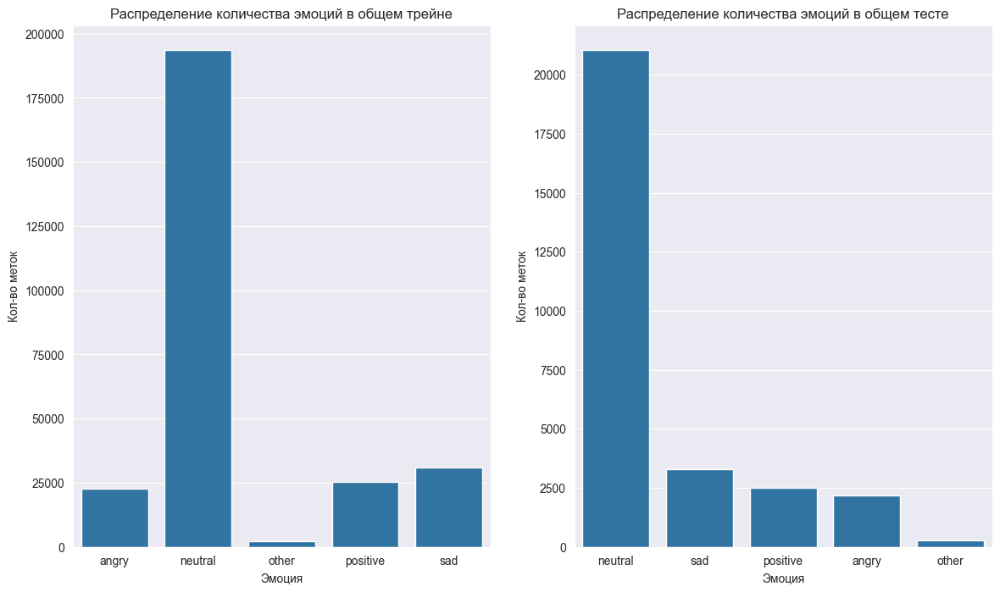

In [31]:
plt.figure(figsize=(14,8))
plt.subplot(1, 2, 1)
sns.countplot(full_train, x='annotator_emo')
plt.xlabel('Эмоция')
plt.ylabel("Кол-во меток")
plt.title('Распределение количества эмоций в общем трейне')
plt.subplot(1,2,2)
sns.countplot(full_test, x='annotator_emo')
plt.xlabel('Эмоция')
plt.ylabel("Кол-во меток")
plt.title('Распределение количества эмоций в общем тесте')
plt.show()


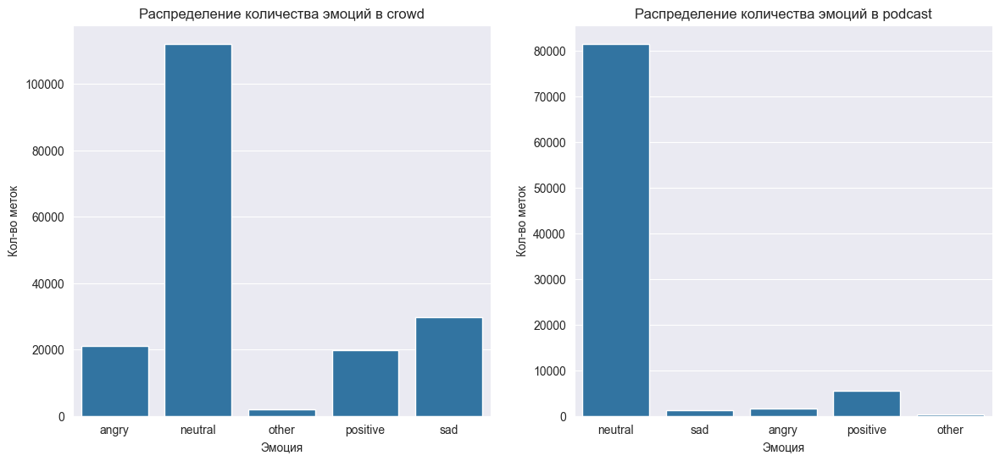

In [32]:
plt.figure(figsize=(14,6))
plt.subplot(1, 2, 1)
sns.countplot(crowd_train, x='annotator_emo')
plt.xlabel('Эмоция')
plt.ylabel("Кол-во меток")
plt.title('Распределение количества эмоций в crowd')
plt.subplot(1,2,2)
sns.countplot(podcast_train, x='annotator_emo')
plt.xlabel('Эмоция')
plt.ylabel("Кол-во меток")
plt.title('Распределение количества эмоций в podcast')
plt.show()


In [33]:
crowd_train['dataset'] = 'crowd'
podcast_train['dataset'] = 'podcast'

combined_data = pd.concat([crowd_train, podcast_train])

C:\Users\777\AppData\Local\Temp\ipykernel_100676\1824257678.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  crowd_train['dataset'] = 'crowd'
C:\Users\777\AppData\Local\Temp\ipykernel_100676\1824257678.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  podcast_train['dataset'] = 'podcast'


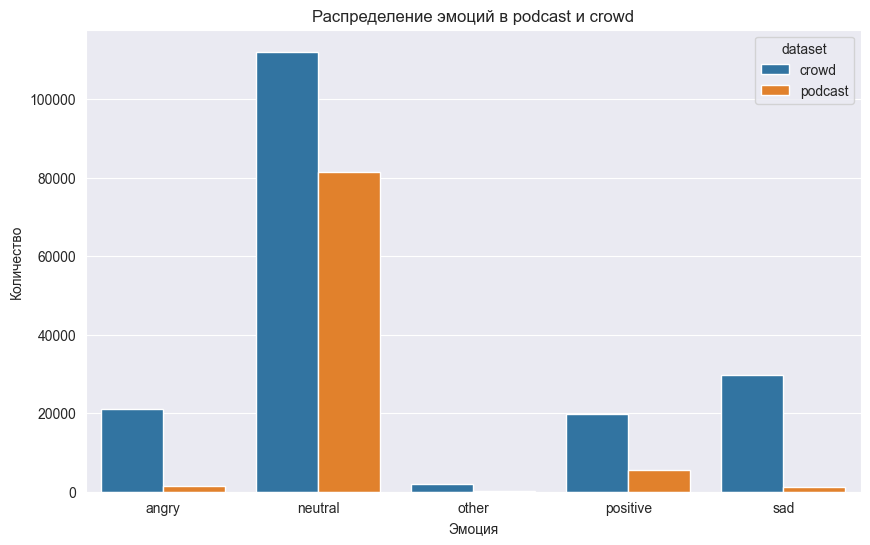

In [34]:
plt.figure(figsize=(10, 6))
sns.countplot(x='annotator_emo', data=combined_data, hue='dataset')
plt.title('Распределение эмоций в podcast и crowd')
plt.xlabel('Эмоция')
plt.ylabel('Количество')
plt.show()

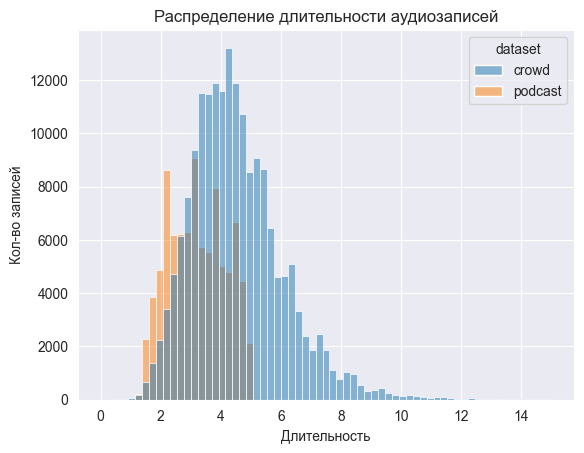

In [35]:
# Построение гистограммы с указанием столбца 'dataset' для раскраски
sns.histplot(data=combined_data, x='duration', hue='dataset',binrange=(0,15), bins=65)
plt.xlabel('Длительность')
plt.ylabel('Кол-во записей')
plt.title('Распределение длительности аудиозаписей')
plt.show()

In [36]:
crowd_train

,hash_id,audio_path,duration,annotator_emo,golden_emo,annotator_id,speaker_text,speaker_emo,source_id,dataset
0,475e76f77ac1ed7cabafca740b15b32a,475e76f77ac1ed7cabafca740b15b32a.wav,2.453000,angry,NaN,858305a5450b7bd1288ba0053b1cd1c1,не надо не надо не надо не надо,angry,fa136da095807ea6cd18dd6e2f58d4d0,crowd
1,2f9438ef68395c70a8714dc373a49d11,2f9438ef68395c70a8714dc373a49d11.wav,4.640000,neutral,NaN,858305a5450b7bd1288ba0053b1cd1c1,фозил кори mp три,neutral,3d436884cbbe25373914f8768de494f7,crowd
2,9937036a9c0dba20eecbffddd00f2be2,9937036a9c0dba20eecbffddd00f2be2.wav,4.341750,neutral,2.0,858305a5450b7bd1288ba0053b1cd1c1,NaN,NaN,NaN,crowd
3,fb0ae78586a235018103acec22a80a8f,fb0ae78586a235018103acec22a80a8f.wav,3.900562,neutral,NaN,858305a5450b7bd1288ba0053b1cd1c1,сколько стоит на керамбит,neutral,80bc833cf6b3f106d2e8991783a31e2b,crowd
4,196dcf9e1aaac46c2aee45e7f6adfb92,196dcf9e1aaac46c2aee45e7f6adfb92.wav,4.780000,neutral,NaN,858305a5450b7bd1288ba0053b1cd1c1,афина когда закончится эта телепередача,neutral,bd78f079676fa5f1ed17253c9a440cc6,crowd
...,...,...,...,...,...,...,...,...,...,...
906905,485f6a9205f4615c18076753290f04e2,485f6a9205f4615c18076753290f04e2.wav,2.948562,neutral,NaN,35dc87272649dba37e9a8a114917ff18,мультик лего пожарный,neutral,9a3e249624d79bf823bc9c77d2d6bb2d,crowd
906906,9bba65658c63cab3d637d90cd9a697ce,9bba65658c63cab3d637d90cd9a697ce.wav,3.920000,neutral,NaN,35dc87272649dba37e9a8a114917ff18,спирит оф зе,sad,68204b5c837951ebabc26e45cb649fc0,crowd
906907,29519c32a224aeac5888ea650eb6af6d,29519c32a224aeac5888ea650eb6af6d.wav,4.740000,neutral,NaN,35dc87272649dba37e9a8a114917ff18,блин прикольно,neutral,6d82ca27f40defbcb07c07cd210c4735,crowd
906908,ac99bed2514c47d20030e4c34eb0d6cc,ac99bed2514c47d20030e4c34eb0d6cc.wav,3.760000,neutral,NaN,35dc87272649dba37e9a8a114917ff18,последний богатырь фильм первый,neutral,2f53ec2f07d56af5ce9243569d4eb832,crowd


Text(0.5, 1.0, 'Распределение количества эмоций в crowd')

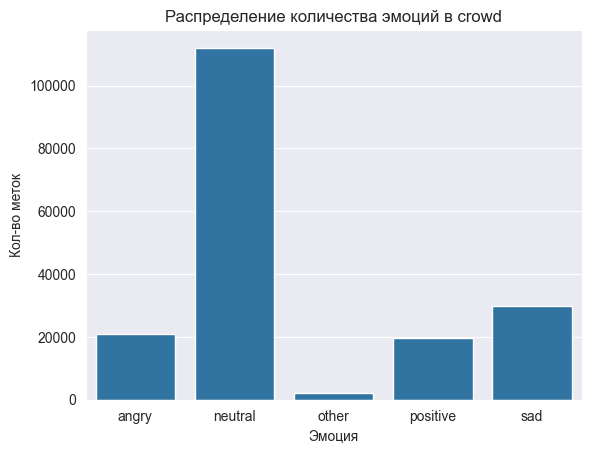

In [37]:
sns.countplot(crowd_train, x='annotator_emo')
plt.xlabel('Эмоция')
plt.ylabel("Кол-во меток")
plt.title('Распределение количества эмоций в crowd')

Text(0.5, 1.0, 'Зависимость длительности фрагмента от эмоции в Podcast')

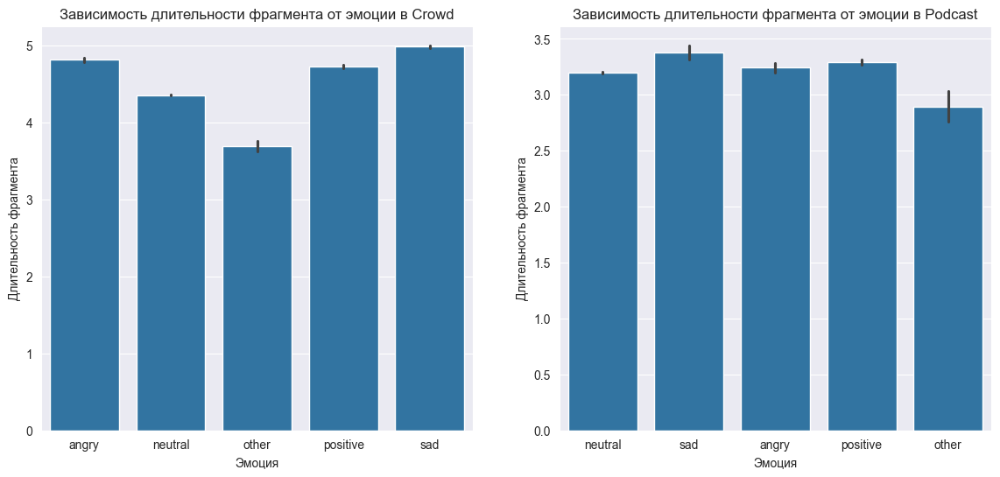

In [38]:
plt.figure(figsize=(14,6))
plt.subplot(1, 2, 1)
sns.barplot(crowd_train, x=crowd_train.annotator_emo, y = crowd_train.duration)
plt.xlabel('Эмоция')
plt.ylabel("Длительность фрагмента")
plt.title('Зависимость длительности фрагмента от эмоции в Crowd')
plt.subplot(1, 2, 2)
sns.barplot(podcast_train, x=podcast_train.annotator_emo, y = podcast_train.duration)
plt.xlabel('Эмоция')
plt.ylabel("Длительность фрагмента")
plt.title('Зависимость длительности фрагмента от эмоции в Podcast')

C:\Users\777\AppData\Local\Temp\ipykernel_100676\2333065865.py:7: UserWarning: amplitude_to_db was called on complex input so phase information will be discarded. To suppress this warning, call amplitude_to_db(np.abs(S)) instead.
  D = librosa.amplitude_to_db(librosa.stft(y), ref=np.max)


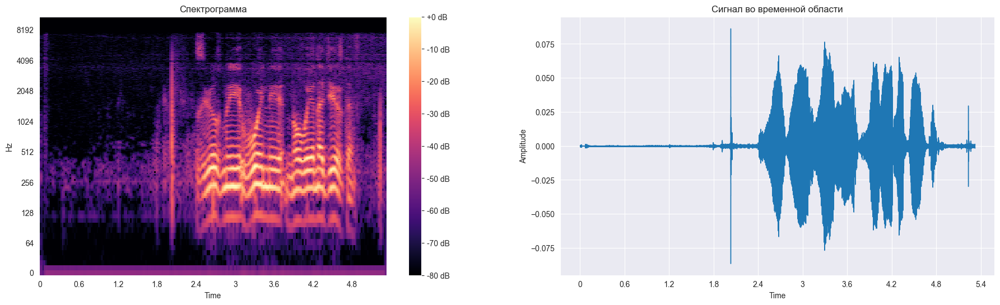

Текст записи: звездные войны новая надежда


In [40]:
audio_path = r'C:\Users\777\Documents\dusha\DATASET_PATH\wavs_test\0a0b4bcc84b23c3d780affde94948853.wav'
y, sr = librosa.load(audio_path)

# Создание спектрограммы
plt.figure(figsize=(22,6))
plt.subplot(1, 2, 1)
D = librosa.amplitude_to_db(librosa.stft(y), ref=np.max)
librosa.display.specshow(D, sr=sr, x_axis='time', y_axis='log')
plt.colorbar(format='%+2.0f dB')
plt.title('Спектрограмма')
plt.subplot(1, 2, 2)
librosa.display.waveshow(y, sr=sr)
plt.xlabel('Time')
plt.ylabel('Amplitude')
plt.title('Сигнал во временной области')
plt.show()
print('Текст записи:', crowd_test.loc[crowd_test['audio_path'] == r'0a0b4bcc84b23c3d780affde94948853.wav'].speaker_text[61324])
Audio(r'C:\Users\777\Documents\dusha\DATASET_PATH\wavs_test\0a0b4bcc84b23c3d780affde94948853.wav')

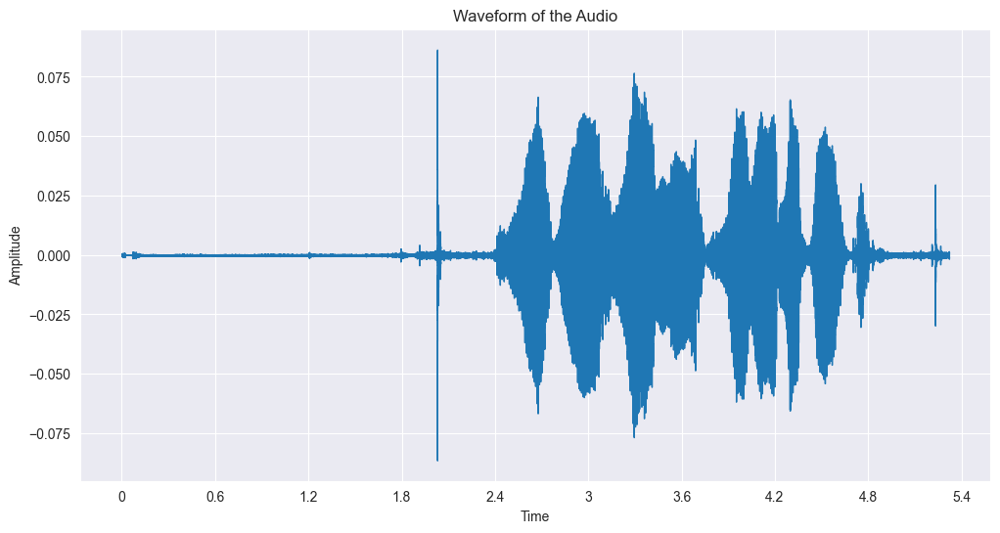

In [41]:
y, sr = librosa.load(audio_path)

# Отображение звуковой дорожки
plt.figure(figsize=(12, 6))
librosa.display.waveshow(y, sr=sr)
plt.xlabel('Time')
plt.ylabel('Amplitude')
plt.title('Waveform of the Audio')
plt.show()

## челы со сбера дичь в данных сделали, поэтому пришлось переделывать

In [42]:
podcast_train = pd.read_csv('podcast_train.csv', delimiter='\t')
podcast_test = pd.read_csv('podcast_test.csv', delimiter='\t')
crowd_test = pd.read_csv('crowd_test.csv', delimiter='\t')
crowd_train = pd.read_csv('crowd_train.csv', delimiter='\t')
podcast_train = podcast_train.drop(columns=['Unnamed: 0'])
podcast_test = podcast_test.drop(columns=['Unnamed: 0'])
crowd_train = crowd_train.drop(columns=['Unnamed: 0'])
crowd_test = crowd_test.drop(columns=['Unnamed: 0'])

In [43]:
x = rnd.randint(1,10000)
print(x)
Audio(fr'C:\Users\777\Documents\dusha\DATASET_PATH\wavs_test\{crowd_test.audio_path[x]}')

7722


In [44]:
x = rnd.randint(1,10000)
sampling_rate, data=read_wav(fr'C:\Users\777\Documents\dusha\DATASET_PATH\wavs_train\{podcast_train.audio_path[x]}')
print(sampling_rate)
Audio(fr'C:\Users\777\Documents\dusha\DATASET_PATH\wavs_train\{podcast_train.audio_path[x]}')

16000


## предлагается взять все эмоциональные метки и соединить их в один датасет train общий и зашавлить немного нейтралей ото всюду и добавить их в датасет

In [45]:
podcast_train_filt = podcast_train.loc[podcast_train['annotator_emo'].isin(['positive','sad','angry','other'])]
podcast_train_neutral = podcast_train.loc[podcast_train['annotator_emo']=='neutral']
crowd_train_filt = crowd_train.loc[crowd_train['annotator_emo'].isin(['positive','sad','angry','other'])]
crowd_train_neutral = crowd_train.loc[crowd_train['annotator_emo']=='neutral']
major_train_emotional = pd.concat([crowd_train_filt, podcast_train_filt], axis=0)
major_train_neutral = pd.concat([crowd_train_neutral, podcast_train_neutral], axis=0)
sample_neutral = major_train_neutral.sample(n=80000, replace=False)
major_train = pd.concat([sample_neutral, major_train_emotional], axis=0)
major_train = major_train.reset_index()
major_train.drop(columns=['index'], inplace=True)

In [46]:
print(major_train.annotator_emo.value_counts())

annotator_emo
neutral     80000
sad         30902
positive    25310
angry       22569
other        2282
Name: count, dtype: int64


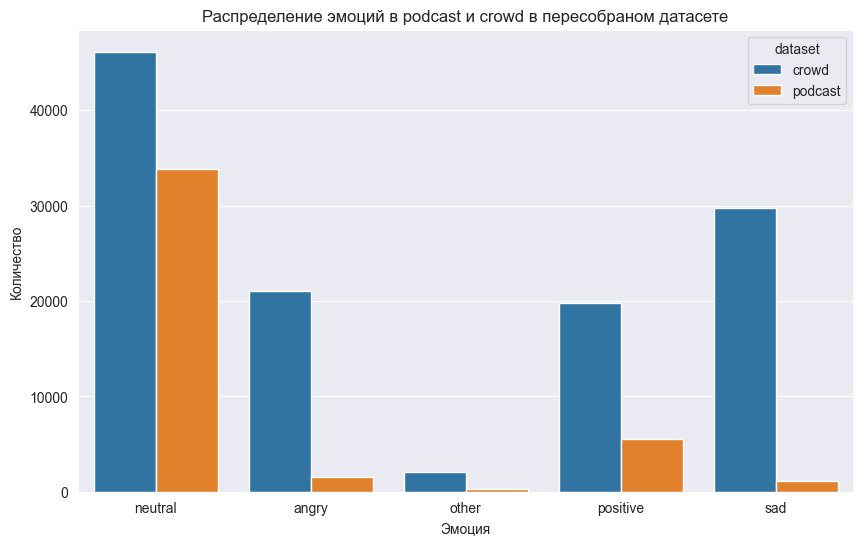

In [47]:
plt.figure(figsize=(10, 6))
sns.countplot(x='annotator_emo', data=major_train, hue='dataset')
plt.title('Распределение эмоций в podcast и crowd в пересобраном датасете')
plt.xlabel('Эмоция')
plt.ylabel('Количество')
plt.show()

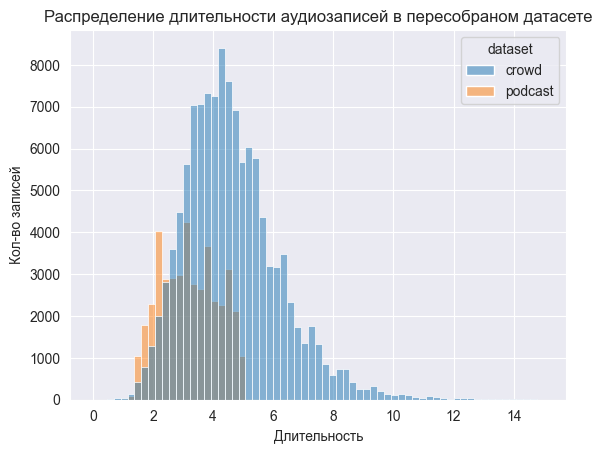

4.267337043191174


In [48]:
sns.histplot(data=major_train, x='duration', hue='dataset',binrange=(0,15), bins=65)
plt.xlabel('Длительность')
plt.ylabel('Кол-во записей')
plt.title('Распределение длительности аудиозаписей в пересобраном датасете')
plt.show()
print(major_train.duration.mean())

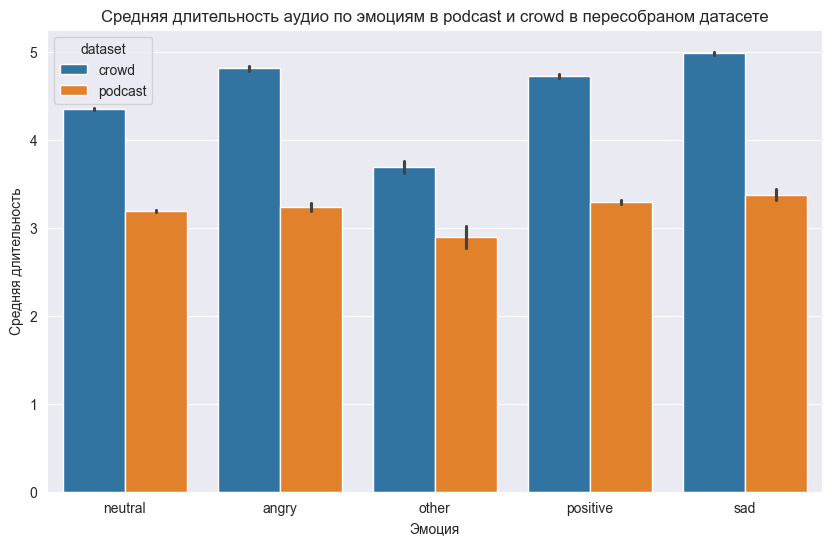

In [49]:
plt.figure(figsize=(10, 6))
sns.barplot(x='annotator_emo', y='duration', data=major_train, hue='dataset', estimator=np.mean)
plt.title('Средняя длительность аудио по эмоциям в podcast и crowd в пересобраном датасете')
plt.xlabel('Эмоция')
plt.ylabel('Средняя длительность')
plt.show()


In [50]:
Audio(fr'C:\Users\777\Documents\dusha\DATASET_PATH\wavs_train\{major_train.loc[(major_train["duration"] > 6) & (major_train["dataset"] == "podcast")].audio_path[152857]}')

In [53]:
x = rnd.randint(1,1000)
Audio(fr'C:\Users\777\Documents\dusha\DATASET_PATH\wavs_train\{major_train.loc[(major_train["duration"] > 6) & (major_train["dataset"] == "crowd")].audio_path[11]}')


## в общем, в крауде спокойно можно выкидывать первую секунду. Слушать запись предлагаю до 6 секунды, то есть будут куски по 5 сек.
дальше есть несколько вариков:
1) заполнять недостатки шумом
2) ничем не заполнять недостатки


# Features


#### Обычный waveform

In [57]:
print ("Текст записи:", major_train.loc[(major_train["duration"] < 3) & (major_train["dataset"] == "crowd")].speaker_text[17])
print('Эмоция -->', major_train.loc[(major_train["duration"] < 3) & (major_train["dataset"] == "crowd")].speaker_emo[17])
Audio(fr'C:\Users\777\Documents\dusha\DATASET_PATH\wavs_train\{major_train.loc[(major_train["duration"] < 3) & (major_train["dataset"] == "crowd")].audio_path[17]}')

Текст записи: ты горишь как огонь
Эмоция --> neutral


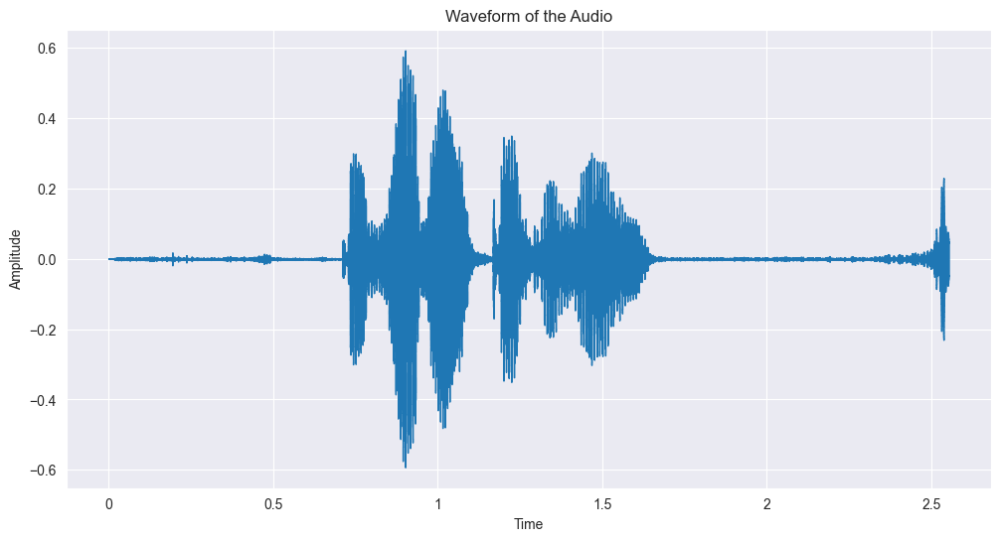

In [58]:
y, sr = librosa.load(fr'C:\Users\777\Documents\dusha\DATASET_PATH\wavs_train\{major_train.loc[(major_train["duration"] < 3) & (major_train["dataset"] == "crowd")].audio_path[17]}')

# Отображение звуковой дорожки
plt.figure(figsize=(12, 6))
librosa.display.waveshow(y, sr=sr)
plt.xlabel('Time')
plt.ylabel('Amplitude')
plt.title('Waveform of the Audio')
plt.show()

#### Разделение гармонических и тональных сигналов
Результатом является то, что временной ряд y был разделен на два временных ряда, содержащих гармоническую и перкуссионную части сигнала. Каждый из y_harmonic и y_percussive имеет ту же форму и продолжительность, что и y

Text(0.5, 1.0, 'Harmonic + Percussive')

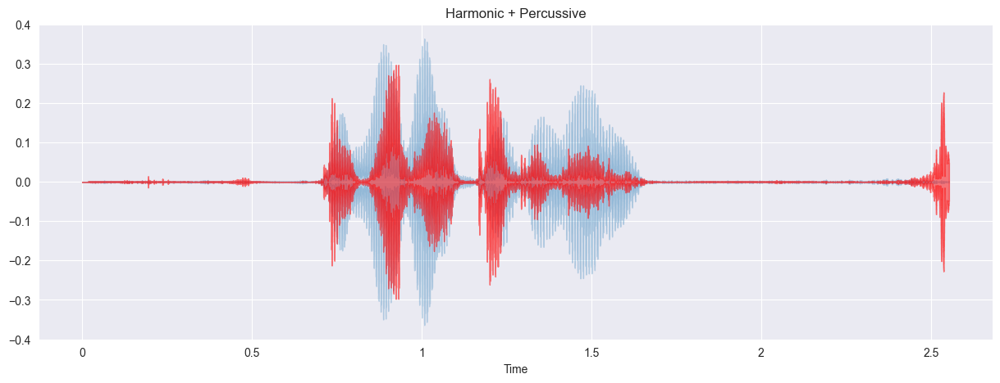

In [59]:
y_harmonic, y_percussive = librosa.effects.hpss(y)
plt.figure(figsize=(15, 5))
librosa.display.waveshow(y_harmonic, sr=sr, alpha=0.25)
librosa.display.waveshow(y_percussive, sr=sr, color='r', alpha=0.5)
plt.title('Harmonic + Percussive')

#### Нормализованная энергия цветности - Chroma Energy Normalized (CENS)
Функции цветности основаны на двенадцати атрибутах написания основного тона, как используется в западной нотной записи, где каждый вектор цветности указывает, как энергия в кадре сигнала распределяется по двенадцати полосам цветности. Измерение таких распределений во времени дает представление времени и цветности (или хромаграмму ), которое тесно коррелирует с мелодической и гармонической прогрессией. Такие последовательности часто схожи для разных записей одного и того же. Нормализованная энергия цветности применяется для сопоставления звука, где допускаются вариации, поскольку они обычно появляются в разных исполнениях . Например, два разных исполнения одного и того же, могут демонстрировать значительные нелинейные глобальные и локальные различия в темпе, артикуляции и фразировке.

C:\Users\777\anaconda3\lib\site-packages\librosa\core\spectrum.py:257: UserWarning: n_fft=1024 is too large for input signal of length=880
  warnings.warn(


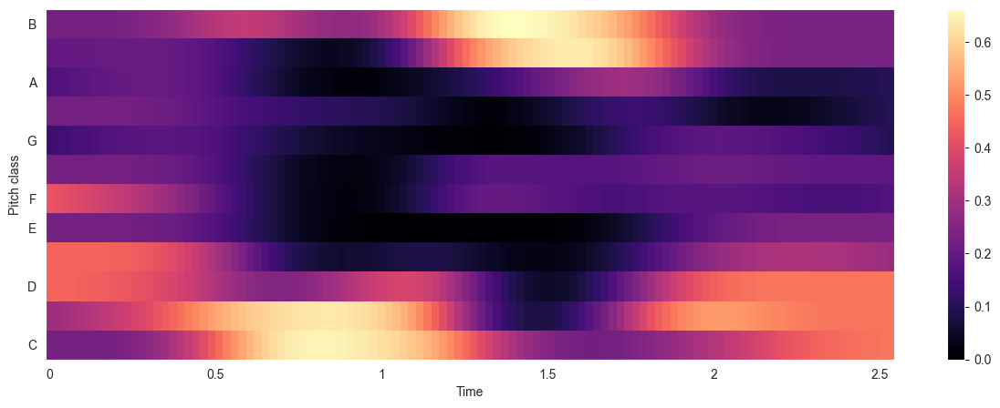

In [60]:
chroma=librosa.feature.chroma_cens(y=y_harmonic, sr=sr)
plt.figure(figsize=(15, 5))
librosa.display.specshow(chroma,y_axis='chroma', x_axis='time')
plt.colorbar()

#### Мел-кепстральные коэффициенты (MFCC).
Мел-кепстральные коэффициенты — один из важнейших признаков в обработке аудио. MFCC — это матрица значений, которая захватывает тембральные аспекты.

MFCC - Представляют собой набор признаков , которые описывают общую форму спектральной огибающей. Они моделируют характеристики человеческого голоса. MFCC - коэффициенты частотной капсулы, суммируют частотное распределение по размеру окна. Поэтому можно анализировать как частотные, так и временные характеристики звука. Перед построением графика коэффициенты нормализуются.

Text(0.5, 1.0, 'MFCC')

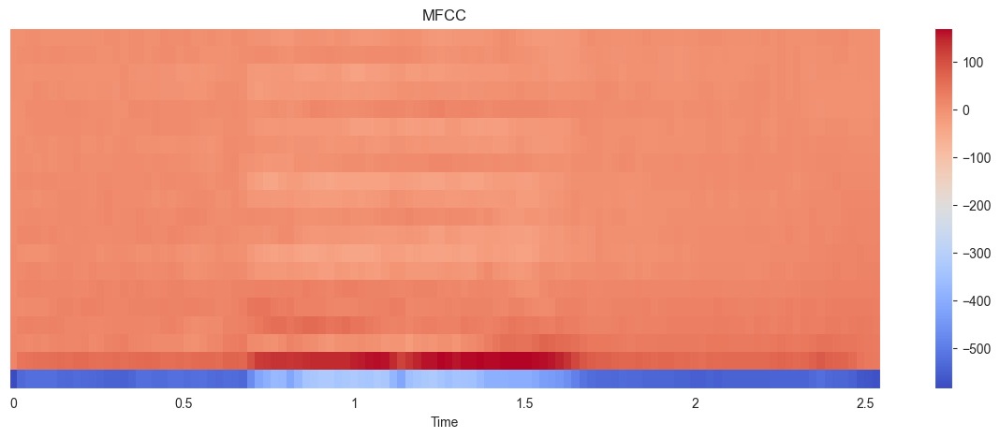

In [61]:
mfccs = librosa.feature.mfcc(y=y_harmonic, sr=sr, n_mfcc=20)
plt.figure(figsize=(15, 5))
librosa.display.specshow(mfccs, x_axis='time')
plt.colorbar()
plt.title('MFCC')

In [62]:
mfccs.shape

(20, 110)

#### Спектрограмма
Спектрограмма - это визуальный способ представления уровня или “громкости” сигнала во времени на различных частотах, присутствующих в форме волны. Обычно изображается в виде тепловой карты. .stft() преобразует данные в кратковременное преобразование Фурье. С помощью STFT можно определить амплитуду различных частот, воспроизводимых в данный момент времени аудиосигнала.

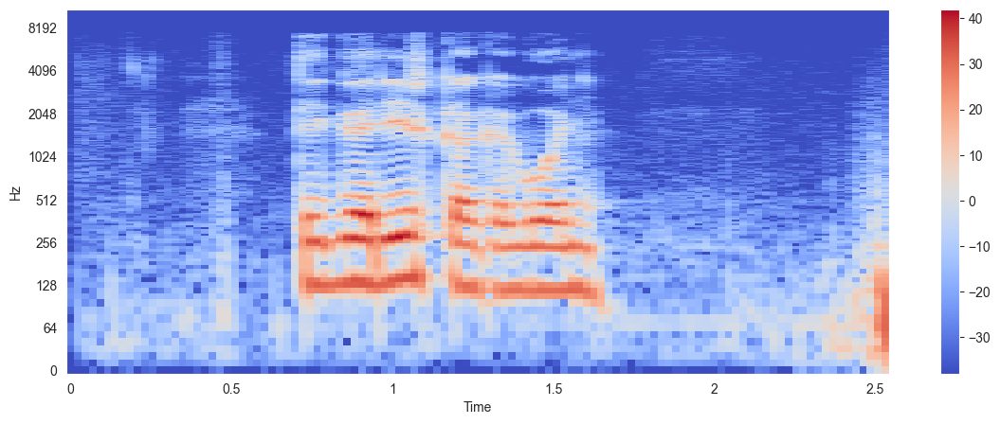

In [63]:
X = librosa.stft(y)
Xdb = librosa.amplitude_to_db(abs(X))
plt.figure(figsize=(14, 5))
librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='log')
plt.colorbar()

#### Спектральный центроид
Указывает, на какой частоте сосредоточена энергия спектра или, другими словами, указывает, где расположен “центр масс” для звука. librosa.feature.spectral_centroid вычисляет спектральный центроид для каждого фрейма в сигнале:

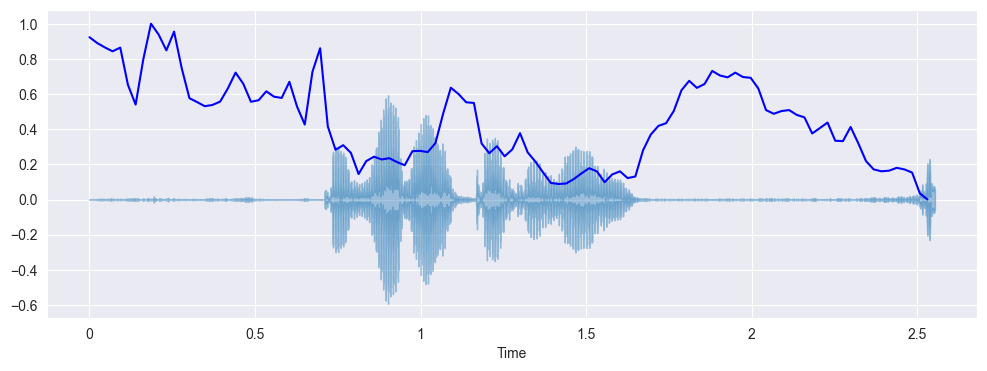

In [64]:
spectral_centroids = librosa.feature.spectral_centroid(y=y, sr=sr)[0]
spectral_centroids.shape

# Вычисление временной переменной для визуализации
plt.figure(figsize=(12, 4))
frames = range(len(spectral_centroids))
t = librosa.frames_to_time(frames)
# Нормализация спектрального центроида для визуализации
def normalize(y, axis=0):
    return sklearn.preprocessing.minmax_scale(y, axis=axis)
# Построение спектрального центроида вместе с формой волны
librosa.display.waveshow(y, sr=sr, alpha=0.4)
plt.plot(t, normalize(spectral_centroids), color='b')

#### Спектральный контраст - Spectral Contrast
Каждый кадр спектрограммы  S делится на поддиапазоны. Для каждого поддиапазона энергетический контраст оценивается путем сравнения средней энергии в верхнем квантиле (энергия пика) со средним значением энергии в нижнем квантиле (энергия впадины). Высокие значения контрастности обычно соответствуют четким узкополосным сигналам, а низкие значения контрастности соответствуют широкополосным шумам.

Text(0.5, 1.0, 'Spectral contrast')

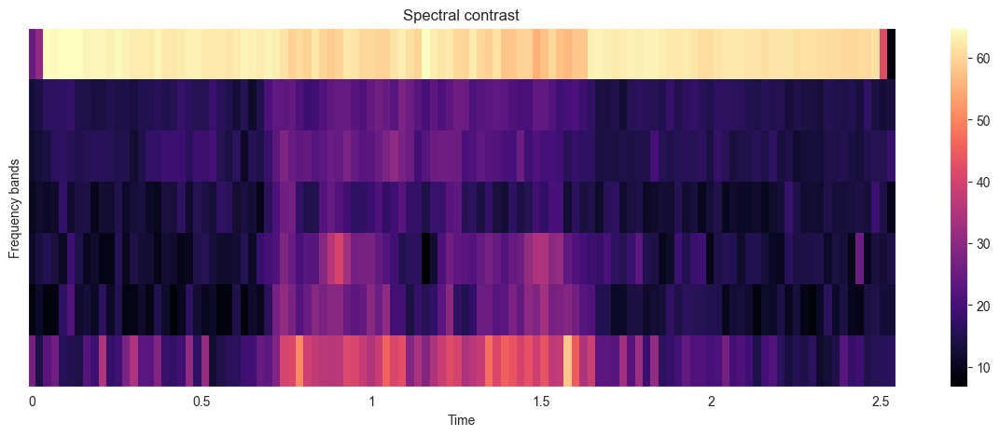

In [65]:
contrast=librosa.feature.spectral_contrast(y=y_harmonic,sr=sr)
plt.figure(figsize=(15,5))
librosa.display.specshow(contrast, x_axis='time')
plt.colorbar()
plt.ylabel('Frequency bands')
plt.title('Spectral contrast')

#### Спектральный спад - Spectral Rolloff.
Это мера формы сигнала, представляющая собой частоту, в которой высокие частоты снижаются до 0. Чтобы получить ее, нужно рассчитать долю элементов в спектре мощности, где 85% ее мощности находится на более низких частотах. librosa.feature.spectral_rolloff вычисляет частоту спада для каждого фрейма в сигнале:

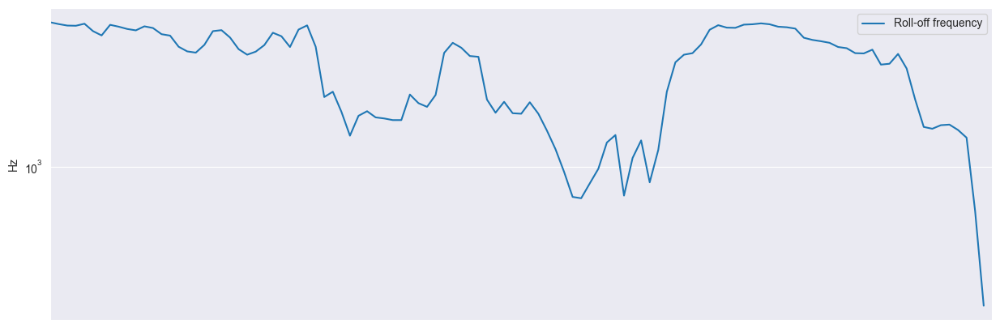

In [66]:
 # Spectral Rolloff
rolloff = librosa.feature.spectral_rolloff(y=y, sr=sr)
plt.figure(figsize=(15,5))
plt.semilogy(rolloff.T, label='Roll-off frequency')
plt.ylabel('Hz')
plt.xticks([])
plt.xlim([0, rolloff.shape[-1]])
plt.legend()

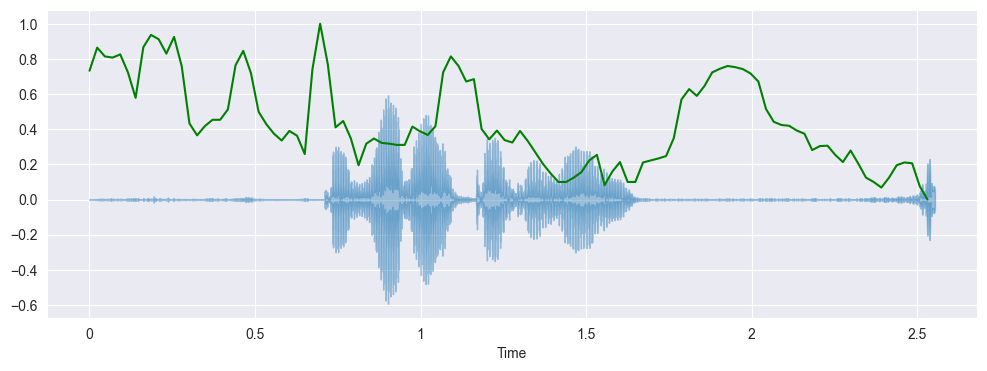

In [67]:
spectral_rolloff = librosa.feature.spectral_rolloff(y=y+0.01, sr=sr)[0]
plt.figure(figsize=(12, 4))
librosa.display.waveshow(y, sr=sr, alpha=0.4)
plt.plot(t, normalize(spectral_rolloff), color='g')

# Обработка данных

In [68]:
major_train

,hash_id,audio_path,duration,annotator_emo,golden_emo,annotator_id,speaker_text,speaker_emo,source_id,dataset
0,e330e54918af4190289453f793207430,e330e54918af4190289453f793207430.wav,3.10,neutral,NaN,b94b5ec25333762fe53501513556443a,диана бунтарка,neutral,1a9556a329c3aee037c308e0447e58ac,crowd
1,1680f5f37fb9d51f9e276ae83def260b,1680f5f37fb9d51f9e276ae83def260b.wav,3.40,neutral,NaN,50069c7f7ba37d498ebc3ae7aa261879,NaN,NaN,d862314789a3f9cd614de3a0c2a948b4,podcast
2,251a3587042102ccae90edfd2748dfbe,251a3587042102ccae90edfd2748dfbe.wav,4.74,neutral,NaN,c085ab4a414bc90eba9f93915e636974,песни милаы гогунской,sad,dfa6ac3d15b463dfc8b5b93abf3c9eb7,crowd
3,a39098c6acde6c54c8607fcb6e878ba0,a39098c6acde6c54c8607fcb6e878ba0.wav,3.54,neutral,NaN,5c96f76207a187f7762a605a77af78bd,салют город орел девятое мая,positive,52c545ae8efcee9d268be4dc793cc7ea,crowd
4,20d1125cedc0fe3d358f62b47ebd3cb3,20d1125cedc0fe3d358f62b47ebd3cb3.wav,3.48,neutral,NaN,54875be1980aa9fccb75391f6b3f9fd5,в вк зайди пожалуйста,neutral,b96c3b3ab3aa894482d6cb4e48e7b64d,crowd
...,...,...,...,...,...,...,...,...,...,...
161058,55a54d98443cb0edc9aa78d79e23db94,55a54d98443cb0edc9aa78d79e23db94.wav,3.80,positive,NaN,478ece03f1b19f637b7e7e10a1c4ec18,NaN,NaN,763d3f7e3283b1a518d3e55c6fe94453,podcast
161059,1ab446e4e07e257f185718d60f0fa987,1ab446e4e07e257f185718d60f0fa987.wav,2.00,sad,NaN,0f138ca8a0ce058f48d47cda85753439,NaN,NaN,0bd05f242495d97466c5674653ae32cb,podcast
161060,c9e515550d451c497c5434c1e12d61a9,c9e515550d451c497c5434c1e12d61a9.wav,4.80,positive,NaN,0f138ca8a0ce058f48d47cda85753439,NaN,NaN,becdf05079e4884fa8a8276d1a488f1d,podcast
161061,be1553e2d7651dfc6360db8594001262,be1553e2d7651dfc6360db8594001262.wav,2.80,positive,NaN,d6b5eac94428cfad71114fbccbcf4dbc,NaN,NaN,fce116bdeb94468cea73a926ab452205,podcast


In [55]:
Audio(fr'C:\Users\777\Documents\dusha\DATASET_PATH\wavs_train\{major_train.audio_path[43086]}')

In [56]:
Audio(fr'C:\Users\777\Documents\dusha\DATASET_PATH\wavs_train\{major_train.audio_path[23814]}')

In [57]:
# Функция для обрезания или дополнения аудио до нужной длины
def process_audio_noise_podcast(audio_path, target_duration=5.5, discard_sec = 0 , mon=True):
    # Загрузка аудиофайла
    y, sr = librosa.load(audio_path, sr=None, mono=mon)

    # Если длина аудио меньше целевой длины, дополним шумом
    if len(y) < target_duration * sr:
        noise = np.random.normal(0, 0.005, int((target_duration * sr) - len(y)))
        y = np.concatenate([y, noise])
    # Если длина аудио больше целевой длины, обрежем до нужной длины
    elif len(y) > target_duration * sr:
        y = y[:int(target_duration * sr)]
    discard_samples = int(discard_sec * sr)
    y = y[discard_samples:]

    return y, sr

In [58]:
def process_audio_noise_crowd(audio_path, target_duration=6, discard_sec = 0.5 , mon=True):
    # Загрузка аудиофайла
    y, sr = librosa.load(audio_path, sr=None, mono=mon)

    # Если длина аудио меньше целевой длины, дополним шумом
    if len(y) < target_duration * sr:
        noise = np.random.normal(0, 0.005, int((target_duration * sr) - len(y)))
        y = np.concatenate([y, noise])
    # Если длина аудио больше целевой длины, обрежем до нужной длины
    elif len(y) > target_duration * sr:
        y = y[:int(target_duration * sr)]
    discard_samples = int(discard_sec * sr)
    y = y[discard_samples:]

    return y, sr

In [59]:
def process_audio_cycle_crowd(audio_path, target_duration=6, discard_seconds=0.5, mon=True):
    # Загрузка аудиофайла
    y, sr = librosa.load(audio_path, sr=None, mono=mon)

    # Зацикливание аудиофрагмента до достижения целевой длины
    while len(y) < target_duration * sr:
        y = np.concatenate([y, y])

    if len(y) > target_duration * sr:
        y = y[:int(target_duration * sr)]

    # Обрезка аудиофрагмента до нужной длины
    y = y[:int(target_duration * sr)]

    # Отброс первых 0.5 секунд аудио
    discard_samples = int(discard_seconds * sr)
    y = y[discard_samples:]  # Отбрасываем первые 0.5 секунд

    return y, sr

In [60]:
def process_audio_cycle_podcast(audio_path, target_duration=5.5, discard_seconds=0, mon=True):
    # Загрузка аудиофайла
    y, sr = librosa.load(audio_path, sr=None, mono=mon)

    # Зацикливание аудиофрагмента до достижения целевой длины
    while len(y) < target_duration * sr:
        y = np.concatenate([y, y])

    if len(y) > target_duration * sr:
        y = y[:int(target_duration * sr)]

    # Обрезка аудиофрагмента до нужной длины
    y = y[:int(target_duration * sr)]

    # Отброс первых 0.5 секунд аудио
    discard_samples = int(discard_seconds * sr)
    y = y[discard_samples:]  # Отбрасываем первые 0.5 секунд

    return y, sr

In [61]:
# Пример применения функции к аудиофайлу
audio_path = fr'C:\Users\777\Documents\dusha\DATASET_PATH\wavs_train\{major_train.audio_path[43086]}'
processed_audio, sr = process_audio_cycle_podcast(audio_path, mon=True)

In [62]:
Audio(processed_audio, rate=sr)


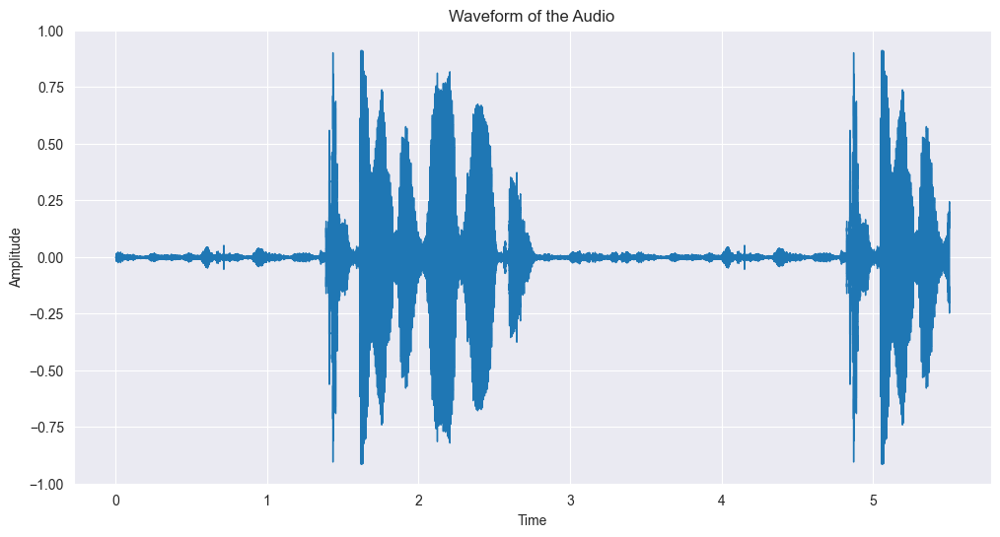

In [63]:
plt.figure(figsize=(12, 6))
librosa.display.waveshow(processed_audio, sr=sr)
plt.xlabel('Time')
plt.ylabel('Amplitude')
plt.title('Waveform of the Audio')
plt.show()

#### Средние значения и стандартные отклонения Мел-кепстральных коэффициентов для записи с шумом
Давайте посмотрим, как выглядят Средние значения и стандартные отклонения Мел-кепстральных коэффициентов в виде двухмерной таблицы (Dataframes), состоящей из столбцов и строки и в виде графика.

Text(0.5, 1.0, 'MFCC')

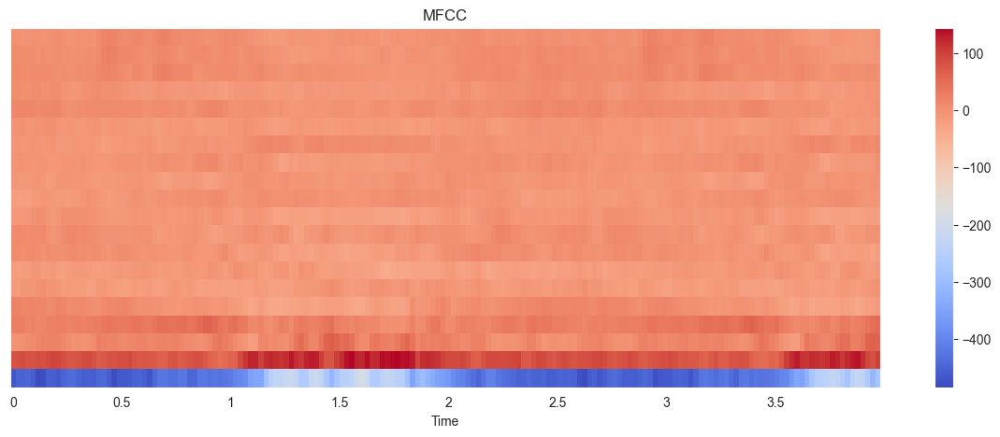

In [64]:
y_harmonic, y_percussive = librosa.effects.hpss(processed_audio)
mfccs = librosa.feature.mfcc(y=y_harmonic, sr=sr, n_mfcc=20)
plt.figure(figsize=(15, 5))
librosa.display.specshow(mfccs, x_axis='time')
plt.colorbar()
plt.title('MFCC')


,mfccs_mean_0,mfccs_mean_1,mfccs_mean_2,mfccs_mean_3,mfccs_mean_4,mfccs_mean_5,mfccs_mean_6,mfccs_mean_7,mfccs_mean_8,mfccs_mean_9,mfccs_mean_10,mfccs_mean_11,mfccs_mean_12,mfccs_mean_13,mfccs_mean_14,mfccs_mean_15,mfccs_mean_16,mfccs_mean_17,mfccs_mean_18,mfccs_mean_19,mfccs_std_0,mfccs_std_1,mfccs_std_2,mfccs_std_3,mfccs_std_4,mfccs_std_5,mfccs_std_6,mfccs_std_7,mfccs_std_8,mfccs_std_9,mfccs_std_10,mfccs_std_11,mfccs_std_12,mfccs_std_13,mfccs_std_14,mfccs_std_15,mfccs_std_16,mfccs_std_17,mfccs_std_18,mfccs_std_19
0,-384.014069,92.246719,17.25951,28.204805,-4.559947,-14.196973,-15.915335,-6.106165,-2.523271,-11.904369,-4.678933,-7.706916,-4.175742,-2.274046,-10.208484,4.188902,-5.783001,6.010181,2.953593,1.607227,87.065636,22.653461,16.050867,12.65123,16.864975,7.019791,8.092944,11.14571,8.545751,9.202321,7.168361,5.955834,7.501742,8.194967,5.139875,7.450665,7.054314,6.643791,8.30325,8.193452


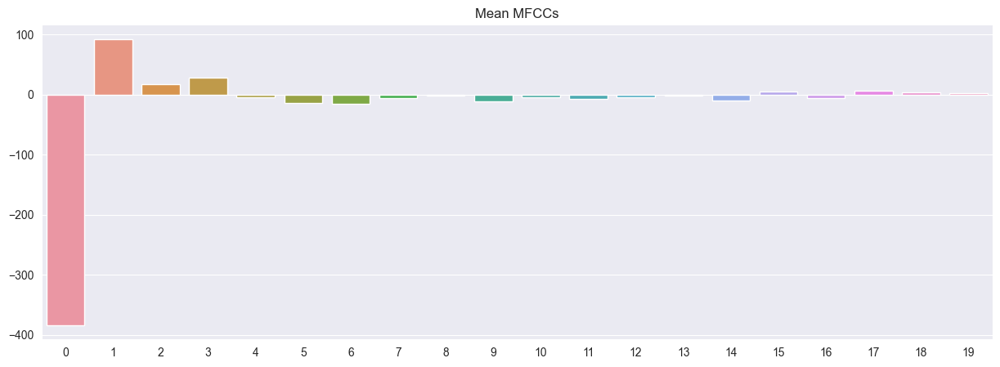

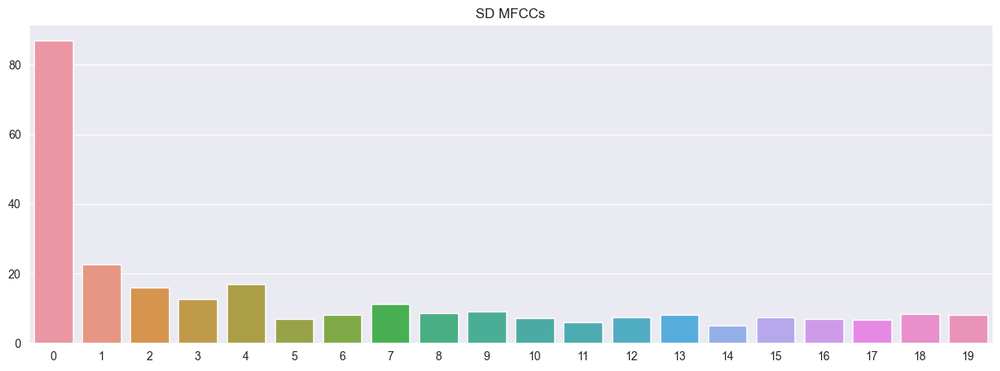

In [65]:
mfccs_mean=np.mean(mfccs,axis=1)
mfccs_std=np.std(mfccs,axis=1)

coeffs=np.arange(0,20)
plt.figure(figsize=(15,5))
plt.title('Mean MFCCs')
sns.barplot(x=coeffs,y=mfccs_mean)

plt.figure(figsize=(15,5))
plt.title('SD MFCCs')
sns.barplot(x=coeffs,y=mfccs_std)
# Generate the chroma Dataframe
mfccs_df=pd.DataFrame()
for i in range(0,20):
    mfccs_df['mfccs_mean_'+str(i)]=mfccs_mean[i]
for i in range(0,20):
    mfccs_df['mfccs_std_'+str(i)]=mfccs_mean[i]
mfccs_df.loc[0]=np.concatenate((mfccs_mean,mfccs_std),axis=0)
mfccs_df

### Спектральный центроид - Spectral Centroid
Спектральный центроид относится к спектральным (частотным) признакам. Спектральные характеристики всех звуковых сигналов определяются с помощью двух зависимостей:

- зависимость амплитуды от времени

- зависимость амплитуды от частоты Спектральный центроид указывает, на какой частоте сосредоточена энергия спектра ( энергия напряжения) или, другими словами, указывает, где расположен “центр масс” для звука.

In [66]:
cent = librosa.feature.spectral_centroid(y=processed_audio, sr=sr)
cent_mean=np.mean(cent)
cent_std=np.std(cent)
cent_skew=scipy.stats.skew(cent,axis=1)[0]
print('Mean: '+str(cent_mean))
print('SD: '+str(cent_std))
print('Skewness: '+str(cent_skew))

Mean: 1708.5451562672365
SD: 672.8306544694649
Skewness: 1.1930547014454262


#### Спектральный спад - Spectral Rolloff
Спектральный спад относится к спектральным (частотным) признакам. Это мера формы сигнала, представляющая собой частоту, в которой высокие частоты снижаются до 0. Чтобы получить ее, нужно рассчитать долю элементов в спектре мощности, где 85% ее мощности находится на более низких частотах.

In [113]:
rolloff = librosa.feature.spectral_rolloff(y=processed_audio, sr=sr)
rolloff_mean=np.mean(rolloff)
rolloff_std=np.std(rolloff)
rolloff_skew=scipy.stats.skew(rolloff,axis=1)[0]
print('Mean: '+str(rolloff_mean))
print('SD: '+str(rolloff_std))
print('Skewness: '+str(rolloff_skew))

Mean: 4042.423691860465
SD: 1493.2211547087238
Skewness: -0.0800412865609555


Извлечение значимых характеристик

In [67]:
def extract_features_with_noise_podcast(file_path):
    name = file_path
    y, sr = process_audio_noise_podcast(name)

    features = []
    features.append(file_path[-36:]) # filename
    features.extend([np.mean(e) for e in librosa.feature.mfcc(y=y, sr=sr,
                                                              n_mfcc=20)])  # mfcc_mean<0..20>
    features.extend([np.std(e) for e in librosa.feature.mfcc(y=y, sr=sr,
                                                             n_mfcc=20)])   # mfcc_std
    features.append(np.mean(librosa.feature.spectral_centroid(y=y, sr=sr).T,
                            axis = 0)[0])     # cent_mean
    features.append(np.std(librosa.feature.spectral_centroid(y=y,sr=sr).T,
                           axis = 0)[0])       # cent_std
    features.append(scipy.stats.skew(librosa.feature.spectral_centroid(y=y,sr=sr).T,
                                     axis = 0)[0])    # cent_skew
    features.append(np.mean(librosa.feature.spectral_rolloff(y=y, sr=sr).T,
                            axis = 0)[0])      # rolloff_mean
    features.append(np.std(librosa.feature.spectral_rolloff(y=y, sr=sr).T,
                           axis = 0)[0])       # rolloff_std
    features.append(str(major_train[major_train['audio_path']==file_path[-36:]].annotator_emo))
    return features

In [68]:
def extract_features_with_noise_crowd(file_path):
    name = file_path
    y, sr = process_audio_noise_crowd(name)

    features = []
    features.append(file_path[-36:]) # filename
    features.extend([np.mean(e) for e in librosa.feature.mfcc(y=y, sr=sr,
                                                              n_mfcc=20)])  # mfcc_mean<0..20>
    features.extend([np.std(e) for e in librosa.feature.mfcc(y=y, sr=sr,
                                                             n_mfcc=20)])   # mfcc_std
    features.append(np.mean(librosa.feature.spectral_centroid(y=y, sr=sr).T,
                            axis = 0)[0])     # cent_mean
    features.append(np.std(librosa.feature.spectral_centroid(y=y,sr=sr).T,
                           axis = 0)[0])       # cent_std
    features.append(scipy.stats.skew(librosa.feature.spectral_centroid(y=y,sr=sr).T,
                                     axis = 0)[0])    # cent_skew
    features.append(np.mean(librosa.feature.spectral_rolloff(y=y, sr=sr).T,
                            axis = 0)[0])      # rolloff_mean
    features.append(np.std(librosa.feature.spectral_rolloff(y=y, sr=sr).T,
                           axis = 0)[0])       # rolloff_std
    features.append(str(major_train[major_train['audio_path']==file_path[-36:]].annotator_emo))
    return features

In [69]:
def extract_features_with_cycle_podcast(file_path):
    name = file_path
    y, sr = process_audio_cycle_podcast(name)

    features = []
    features.append(file_path[-36:]) # filename
    features.extend([np.mean(e) for e in librosa.feature.mfcc(y=y, sr=sr,
                                                              n_mfcc=20)])  # mfcc_mean<0..20>
    features.extend([np.std(e) for e in librosa.feature.mfcc(y=y, sr=sr,
                                                             n_mfcc=20)])   # mfcc_std
    features.append(np.mean(librosa.feature.spectral_centroid(y=y, sr=sr).T,
                            axis = 0)[0])     # cent_mean
    features.append(np.std(librosa.feature.spectral_centroid(y=y,sr=sr).T,
                           axis = 0)[0])       # cent_std
    features.append(scipy.stats.skew(librosa.feature.spectral_centroid(y=y,sr=sr).T,
                                     axis = 0)[0])    # cent_skew
    features.append(np.mean(librosa.feature.spectral_rolloff(y=y, sr=sr).T,
                            axis = 0)[0])      # rolloff_mean
    features.append(np.std(librosa.feature.spectral_rolloff(y=y, sr=sr).T,
                           axis = 0)[0])       # rolloff_std
    features.append(str(major_train[major_train['audio_path']==file_path[-36:]].annotator_emo))
    return features

In [70]:
def extract_features_with_cycle_crowd(file_path):
    name = file_path
    y, sr = process_audio_cycle_crowd(name)

    features = []
    features.append(file_path[-36:]) # filename
    features.extend([np.mean(e) for e in librosa.feature.mfcc(y=y, sr=sr,
                                                              n_mfcc=20)])  # mfcc_mean<0..20>
    features.extend([np.std(e) for e in librosa.feature.mfcc(y=y, sr=sr,
                                                             n_mfcc=20)])   # mfcc_std
    features.append(np.mean(librosa.feature.spectral_centroid(y=y, sr=sr).T,
                            axis = 0)[0])     # cent_mean
    features.append(np.std(librosa.feature.spectral_centroid(y=y,sr=sr).T,
                           axis = 0)[0])       # cent_std
    features.append(scipy.stats.skew(librosa.feature.spectral_centroid(y=y,sr=sr).T,
                                     axis = 0)[0])    # cent_skew
    features.append(np.mean(librosa.feature.spectral_rolloff(y=y, sr=sr).T,
                            axis = 0)[0])      # rolloff_mean
    features.append(np.std(librosa.feature.spectral_rolloff(y=y, sr=sr).T,
                           axis = 0)[0])       # rolloff_std
    features.append(str(major_train[major_train['audio_path']==file_path[-36:]].annotator_emo))
    return features

здесь преобразовывали подкаст с шумом-> 5.5 сек таргет 0 отброс


In [137]:
"""buffer = []
buffer_size = 100
buffer_counter = 0

# Создание заголовка для файла CSV.
header = ['audio_path']
header.extend([f'mfcc_mean{i}' for i in range(1, 21)])
header.extend([f'mfcc_std{i}' for i in range(1, 21)])
header.extend(['cent_mean', 'cent_std', 'cent_skew', 'rolloff_mean', 'rolloff_std',
               'label'])

with open('dataset_podcast_noise.csv', 'w', newline='') as file:
    writer = csv.writer(file, delimiter=',')
    writer.writerow(header)
    for file in major_train[major_train['dataset']=='podcast'].audio_path: #get file names
        features = extract_features_with_noise_podcast(fr'DATASET_PATH\wavs_train\{file}')
        if buffer_counter + 1 == buffer_size:
            buffer.append(features)
            writer.writerows(buffer)
            buffer = []
            buffer_counter = 0
        else:
            buffer.append(features)
            buffer_counter += 1
        if buffer:
            writer.writerows(buffer)
        buffer = []
        buffer_counter = 0"""

In [2]:
podcast_train_noise = pd.read_csv('dataset_podcast_noise.csv')
podcast_train_noise

,audio_path,mfcc_mean1,mfcc_mean2,mfcc_mean3,mfcc_mean4,mfcc_mean5,mfcc_mean6,mfcc_mean7,mfcc_mean8,mfcc_mean9,...,mfcc_std17,mfcc_std18,mfcc_std19,mfcc_std20,cent_mean,cent_std,cent_skew,rolloff_mean,rolloff_std,label
0,5158153917504044ff0844ab87899435.wav,-319.294309,28.890074,9.858651,16.462542,-2.480718,1.432893,-12.708562,-12.538723,-2.699504,...,5.654314,5.116835,5.438964,5.104823,3089.150774,1368.227739,-0.836943,5342.614462,2156.722708,"1 neutral\nName: annotator_emo, dtype: object"
1,e40538ced8b4dff0fd07d0cbab54ac4d.wav,-234.175386,36.413577,8.247422,6.633734,3.950837,2.239078,-0.057224,-1.968632,-1.999052,...,5.369069,5.336646,5.573717,4.151547,3065.278898,1259.070860,-0.736945,5536.246366,1923.804229,"2 neutral\nName: annotator_emo, dtype: object"
2,203dcf3107c04ad45addb2740504d757.wav,-296.681157,20.689858,3.944132,6.788943,0.317742,-0.050694,-4.277966,-0.214784,-2.299038,...,4.287181,3.484910,5.799665,3.657318,3366.166969,1136.691714,-1.546232,5878.542878,1845.065468,"3 neutral\nName: annotator_emo, dtype: object"
3,8f5f23aa62832c77421352c6a028ac67.wav,-252.997215,51.622150,4.419663,27.044573,3.470470,3.295218,-7.740946,-1.500885,-7.972449,...,6.964302,5.952448,6.551504,4.595464,2555.384898,1325.952769,0.101855,4567.678052,2052.817151,"4 neutral\nName: annotator_emo, dtype: object"
4,adfc339f23bacee7acf2b414696ee4e7.wav,-270.827627,61.162682,16.747429,10.162775,3.493166,3.534647,-5.453890,6.320809,2.003002,...,4.463090,6.218594,3.845756,4.117603,2548.142662,1190.053272,-0.005298,4905.250727,1936.811704,"5 neutral\nName: annotator_emo, dtype: object"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
42331,55a54d98443cb0edc9aa78d79e23db94.wav,-266.532924,55.921392,-5.986858,10.752180,-2.328082,-6.262377,0.066371,-12.473870,3.513513,...,7.281112,7.565532,8.938708,6.546746,2582.537614,1282.762019,0.171101,4665.016352,2144.326838,"161058 positive\nName: annotator_emo, dtype..."
42332,1ab446e4e07e257f185718d60f0fa987.wav,-365.399822,16.484795,3.007936,12.174409,2.801758,5.044237,4.183793,-0.523186,-0.833353,...,5.107739,4.290090,4.377455,4.026098,3227.851349,1136.887926,-0.998095,5764.580305,1667.880343,"161059 sad\nName: annotator_emo, dtype: object"
42333,c9e515550d451c497c5434c1e12d61a9.wav,-302.756667,69.304755,-17.377768,14.772776,-11.845004,-14.744764,-14.458475,-13.392545,-11.094988,...,7.664663,8.800359,7.735090,4.834571,2177.476511,1329.562640,0.593591,3837.663517,2167.636010,"161060 positive\nName: annotator_emo, dtype..."
42334,be1553e2d7651dfc6360db8594001262.wav,-278.419369,41.670544,-2.739436,7.679426,0.687615,1.476341,-5.941345,-5.262496,-4.922639,...,5.959951,4.685203,6.082077,5.544755,2953.706589,1172.491697,-0.382260,5318.904433,1767.121207,"161061 positive\nName: annotator_emo, dtype..."


In [3]:
"""buffer = []
buffer_size = 1000
buffer_counter = 0

# Создание заголовка для файла CSV.
header = ['audio_path']
header.extend([f'mfcc_mean{i}' for i in range(1, 21)])
header.extend([f'mfcc_std{i}' for i in range(1, 21)])
header.extend(['cent_mean', 'cent_std', 'cent_skew', 'rolloff_mean', 'rolloff_std',
               'label'])

with open('dataset_podcast_cycle.csv', 'w', newline='') as file:
    writer = csv.writer(file, delimiter=',')
    writer.writerow(header)
    for file in major_train[major_train['dataset']=='podcast'].audio_path: #get file names
        features = extract_features_with_cycle_podcast(fr'DATASET_PATH\wavs_train\{file}')
        if buffer_counter + 1 == buffer_size:
            buffer.append(features)
            writer.writerows(buffer)
            buffer = []
            buffer_counter = 0
        else:
            buffer.append(features)
            buffer_counter += 1
        if buffer:
            writer.writerows(buffer)
        buffer = []
        buffer_counter = 0"""

"buffer = []\nbuffer_size = 1000\nbuffer_counter = 0\n\n# Создание заголовка для файла CSV.\nheader = ['audio_path']\nheader.extend([f'mfcc_mean{i}' for i in range(1, 21)])\nheader.extend([f'mfcc_std{i}' for i in range(1, 21)])\nheader.extend(['cent_mean', 'cent_std', 'cent_skew', 'rolloff_mean', 'rolloff_std',\n               'label'])\n\nwith open('dataset_podcast_cycle.csv', 'w', newline='') as file:\n    writer = csv.writer(file, delimiter=',')\n    writer.writerow(header)\n    for file in major_train[major_train['dataset']=='podcast'].audio_path: #get file names\n        features = extract_features_with_cycle_podcast(fr'DATASET_PATH\\wavs_train\\{file}')\n        if buffer_counter + 1 == buffer_size:\n            buffer.append(features)\n            writer.writerows(buffer)\n            buffer = []\n            buffer_counter = 0\n        else:\n            buffer.append(features)\n            buffer_counter += 1\n        if buffer:\n            writer.writerows(buffer)\n        b

In [3]:
podcast_train_noise = pd.read_csv('dataset_podcast_cycle.csv')
podcast_train_noise

,audio_path,mfcc_mean1,mfcc_mean2,mfcc_mean3,mfcc_mean4,mfcc_mean5,mfcc_mean6,mfcc_mean7,mfcc_mean8,mfcc_mean9,mfcc_mean10,mfcc_mean11,mfcc_mean12,mfcc_mean13,mfcc_mean14,mfcc_mean15,mfcc_mean16,mfcc_mean17,mfcc_mean18,mfcc_mean19,mfcc_mean20,mfcc_std1,mfcc_std2,mfcc_std3,mfcc_std4,mfcc_std5,mfcc_std6,mfcc_std7,mfcc_std8,mfcc_std9,mfcc_std10,mfcc_std11,mfcc_std12,mfcc_std13,mfcc_std14,mfcc_std15,mfcc_std16,mfcc_std17,mfcc_std18,mfcc_std19,mfcc_std20,cent_mean,cent_std,cent_skew,rolloff_mean,rolloff_std,label
0,5158153917504044ff0844ab87899435.wav,-323.255370,81.207750,19.239433,40.477585,-7.804307,3.278185,-33.446148,-33.200848,-7.680809,-14.770613,1.222663,9.813126,-1.421650,6.049303,2.087312,-5.659168,-1.999272,6.031729,-6.991830,-2.401501,145.030140,72.969505,42.270270,31.820219,16.355194,20.297790,21.602037,23.866388,16.608519,12.745991,9.773533,7.415072,11.268166,7.555798,8.278903,9.927253,8.140427,5.738565,6.264623,7.264681,1652.481062,1186.771174,1.486367,3019.304142,1809.014351,"1 neutral\nName: annotator_emo, dtype: object"
1,e40538ced8b4dff0fd07d0cbab54ac4d.wav,-113.867004,100.638214,21.792713,17.410252,8.034764,6.334271,0.414879,-5.705953,-5.610863,9.111138,-2.282503,5.330256,-6.287840,8.257272,-10.120945,0.429585,-6.209764,-3.704848,-6.985035,-0.250216,95.924830,38.218445,25.014118,16.328478,19.761692,14.650597,13.108399,10.167703,11.175156,11.055519,9.266617,7.504594,11.608256,9.598148,10.505914,6.199660,6.606410,7.461046,6.553071,6.007270,1554.197904,722.901990,1.276750,3423.055959,1719.415716,"2 neutral\nName: annotator_emo, dtype: object"
2,203dcf3107c04ad45addb2740504d757.wav,-283.995880,87.701430,13.728547,22.754946,-0.366873,0.281427,-16.665052,-0.864938,-8.598406,0.986548,-0.963775,-3.173005,2.681369,3.457153,-3.993916,0.320632,-5.579373,-3.590393,-8.686476,3.844702,143.468110,52.186714,23.302132,17.094679,22.307423,16.684044,16.370712,6.768546,13.126007,9.218285,7.646343,8.223038,8.125205,9.480585,9.569587,6.110064,5.175346,3.602204,6.355133,5.067564,1651.207280,942.358153,0.253639,3337.481831,2066.861469,"3 neutral\nName: annotator_emo, dtype: object"
3,8f5f23aa62832c77421352c6a028ac67.wav,-206.183690,76.213350,7.619406,38.788017,5.454956,3.549383,-14.224438,-1.369181,-13.924787,-5.984955,1.332529,-2.822296,-5.757420,1.778676,-11.686086,2.426802,-8.407279,-4.776047,-8.469259,0.153881,102.736340,47.019993,34.254093,29.313469,17.100065,18.626350,14.870586,12.459751,13.640052,9.550667,10.604004,9.816427,7.984314,7.626811,9.590367,5.687756,6.939344,6.251672,6.393018,5.585963,1893.108703,1061.237615,1.503751,3543.241279,1556.964531,"4 neutral\nName: annotator_emo, dtype: object"
4,adfc339f23bacee7acf2b414696ee4e7.wav,-275.517180,87.434720,21.519789,13.411670,5.219848,5.483545,-6.906782,9.244144,3.744348,2.941275,-7.024454,-3.695502,-1.810738,4.685296,-0.149680,2.361707,0.481557,6.494947,-0.808248,2.684872,107.811010,39.007904,24.779608,16.249811,8.502652,7.891657,12.352875,8.462659,10.396617,5.990576,8.917718,6.432206,5.093553,4.605859,5.144967,4.628339,5.223966,5.977146,3.915559,4.327794,1929.976228,753.300353,0.121618,4171.784157,1669.415120,"5 neutral\nName: annotator_emo, dtype: object"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
42331,55a54d98443cb0edc9aa78d79e23db94.wav,-245.855290,84.940865,-12.777506,17.208483,-6.787427,-10.581666,-0.936245,-20.021072,3.627672,-9.444312,-0.938536,-13.947513,-6.543857,-3.698267,-11.637028,-0.793448,-4.540292,-4.023922,-10.908104,-5.381938,84.409134,51.946404,41.575570,24.252914,29.359007,18.967050,12.509345,15.668020,14.061615,16.597233,10.451643,14.785978,12.095972,14.683862,8.088262,8.480086,8.428138,8.835983,9.756001,7.119273,1865.695721,1011.843928,1.565729,3534.020712,1881.765570,"161058 positive\nName: annotator_emo, dtype: object"
42332,1ab446e4e07e257f185718d60f0fa987.wav,-463.759400,53.512790,8.285304,34.208702,5.90

здесь преобразовывали крауд с шумом 6 сек таргет 0.5 отброс

In [5]:
"""buffer = []
buffer_size = 100
buffer_counter = 0

# Создание заголовка для файла CSV.
header = ['audio_path']
header.extend([f'mfcc_mean{i}' for i in range(1, 21)])
header.extend([f'mfcc_std{i}' for i in range(1, 21)])
header.extend(['cent_mean', 'cent_std', 'cent_skew', 'rolloff_mean', 'rolloff_std',
               'label'])

with open('dataset_crowd_noise.csv', 'w', newline='') as file:
    writer = csv.writer(file, delimiter=',')
    writer.writerow(header)
    for file in major_train[major_train['dataset']=='crowd'].audio_path: #get file names
        features = extract_features_with_noise_crowd(fr'C:\Users\777\Documents\dusha\DATASET_PATH\wavs_train\{file}')
        if buffer_counter + 1 == buffer_size:
            buffer.append(features)
            writer.writerows(buffer)
            buffer = []
            buffer_counter = 0
        else:
            buffer.append(features)
            buffer_counter += 1
        if buffer:
            writer.writerows(buffer)
        buffer = []
        buffer_counter = 0"""

SyntaxError: (unicode error) 'unicodeescape' codec can't decode bytes in position 837-838: truncated \UXXXXXXXX escape (3465855326.py, line 28)

In [4]:
crowd_train_noise = pd.read_csv('dataset_crowd_noise.csv')
crowd_train_noise

,audio_path,mfcc_mean1,mfcc_mean2,mfcc_mean3,mfcc_mean4,mfcc_mean5,mfcc_mean6,mfcc_mean7,mfcc_mean8,mfcc_mean9,mfcc_mean10,mfcc_mean11,mfcc_mean12,mfcc_mean13,mfcc_mean14,mfcc_mean15,mfcc_mean16,mfcc_mean17,mfcc_mean18,mfcc_mean19,mfcc_mean20,mfcc_std1,mfcc_std2,mfcc_std3,mfcc_std4,mfcc_std5,mfcc_std6,mfcc_std7,mfcc_std8,mfcc_std9,mfcc_std10,mfcc_std11,mfcc_std12,mfcc_std13,mfcc_std14,mfcc_std15,mfcc_std16,mfcc_std17,mfcc_std18,mfcc_std19,mfcc_std20,cent_mean,cent_std,cent_skew,rolloff_mean,rolloff_std,label
0,180e2ec9eb27ecfb6601a144bfbf9c08.wav,-417.196999,60.296673,0.162958,17.073948,2.955306,10.704967,1.392254,4.025679,-4.149722,1.854494,-0.701672,-0.119519,0.529446,2.225929,-0.954188,-0.328533,-0.779162,0.317327,-0.417505,-0.609704,143.639721,58.153996,19.695838,20.950276,10.994999,9.470818,7.464794,9.036900,11.665705,7.471451,4.664963,4.354102,3.962702,4.467117,5.369225,4.227487,3.487987,3.948208,2.847002,3.764032,2552.208465,1178.796382,-0.022354,4910.837573,1829.506310,"0 neutral\nName: annotator_emo, dtype: object"
1,4d96bb3a3e06dc3df328edf62d70e6da.wav,-392.112082,56.103456,9.130655,14.125460,-2.355431,-2.378393,-4.078557,-11.728885,-0.130741,-6.238870,-2.191624,-4.364489,-2.586854,4.239801,-5.024844,3.151734,-4.210131,-0.037548,-5.659058,-1.646195,115.438538,57.442247,15.420287,18.397396,11.873911,5.582872,6.066067,11.835957,5.721463,7.928515,5.414836,6.145214,7.234187,6.534822,7.487494,4.562718,7.421540,4.157830,7.276784,3.454209,2644.195940,1266.271543,0.071199,4974.336846,1854.250101,"8 neutral\nName: annotator_emo, dtype: object"
2,ef3424abebca2e4bd4e5bdff966d0029.wav,-435.143950,99.111440,29.734007,21.079353,21.021538,19.889008,14.519778,15.298590,3.010282,2.277166,4.823776,4.607040,11.128979,4.283184,7.214674,6.696122,0.669616,3.896694,3.994768,3.843213,96.133934,22.058903,19.785568,14.972573,13.069415,15.405511,13.834852,6.715369,9.160903,5.434332,6.415435,9.089515,7.229605,7.652348,4.969175,6.005465,7.460927,4.156457,4.219387,3.916277,970.429364,632.935749,3.559366,1924.146076,1395.603964,"11 neutral\nName: annotator_emo, dtype: object"
3,1445248482da5db46d38029617ac89a4.wav,-470.198014,13.555922,3.673559,-4.240874,0.702192,-3.755201,-0.321012,-2.073531,-3.415162,-1.519689,-3.903832,-1.334800,-2.807967,1.232592,-1.654989,-1.028368,-1.609744,-1.753385,-0.676156,-1.106154,177.451972,38.349782,14.885240,13.207395,10.486409,15.697632,9.460643,9.159868,9.529230,6.334092,8.583875,4.919791,8.248656,5.087342,4.999269,5.391873,3.980452,7.120730,3.782198,4.940295,3497.049424,869.512614,-1.435931,6210.619549,1345.915115,"12 neutral\nName: annotator_emo, dtype: object"
4,c92ccadb54275cfdf9ae2ec5328e0c44.wav,-492.476993,52.863946,10.169741,-8.829163,3.426911,-0.289099,-4.357158,-1.603504,-6.222369,-0.845632,-1.171194,5.846378,-1.129260,8.241696,-1.564559,0.022718,-1.086052,-0.300568,-2.872380,-1.015646,194.008827,62.089413,17.275591,21.518865,14.283957,13.409918,12.169055,7.841156,15.246275,8.708287,11.296170,7.687052,8.649914,9.349564,8.170866,6.438350,7.082688,5.270082,6.171090,5.649261,2773.859623,1313.241981,-0.056769,5041.651526,2185.457845,"13 neutral\nName: annotator_emo, dtype: object"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
118722,6368654eab71a47e6d9ff4e846c17985.wav,-282.990880,15.566238,-5.550830,-6.247572,-27.540585,-32.594364,-20.252440,-19.836740,-21.833610,-3.231508,-14.964249,-3.635193,-14.879270,-8.540065,-13.038589,-9.002732,-9.475420,-8.818267,-4.490953,-2.270721,56.094234,39.391907,14.050855,13.652239,11.645551,11.005224,9.020541,10.679311,10.622349,9.355360,10.940964,8.610011,8.127374,4.451495,4.918456,5.208376,5.406085,7.101984,6.184901,6.165962,3044.346847,865.091022,-0.942825,5699.309593,1218.333999,"152556 sad\nName: annotator_emo, dtype: object"
118723,41fdb0023038bfdfff12da17cef3e21f.wav,-565.001384,50.655920,11.138350,7.761943,-3.463824,-3.1403

In [7]:
"""buffer = []
buffer_size = 1000
buffer_counter = 0

# Создание заголовка для файла CSV.
header = ['audio_path']
header.extend([f'mfcc_mean{i}' for i in range(1, 21)])
header.extend([f'mfcc_std{i}' for i in range(1, 21)])
header.extend(['cent_mean', 'cent_std', 'cent_skew', 'rolloff_mean', 'rolloff_std',
               'label'])

with open('dataset_crowd_cycle.csv', 'w', newline='') as file:
    writer = csv.writer(file, delimiter=',')
    writer.writerow(header)
    for file in major_train[major_train['dataset']=='crowd'].audio_path: #get file names
        features = extract_features_with_cycle_crowd(fr'DATASET_PATH\wavs_train\{file}')
        if buffer_counter + 1 == buffer_size:
            buffer.append(features)
            writer.writerows(buffer)
            buffer = []
            buffer_counter = 0
        else:
            buffer.append(features)
            buffer_counter += 1
        if buffer:
            writer.writerows(buffer)
        buffer = []
        buffer_counter = 0"""

"buffer = []\nbuffer_size = 1000\nbuffer_counter = 0\n\n# Создание заголовка для файла CSV.\nheader = ['audio_path']\nheader.extend([f'mfcc_mean{i}' for i in range(1, 21)])\nheader.extend([f'mfcc_std{i}' for i in range(1, 21)])\nheader.extend(['cent_mean', 'cent_std', 'cent_skew', 'rolloff_mean', 'rolloff_std',\n               'label'])\n\nwith open('dataset_crowd_cycle.csv', 'w', newline='') as file:\n    writer = csv.writer(file, delimiter=',')\n    writer.writerow(header)\n    for file in major_train[major_train['dataset']=='crowd'].audio_path: #get file names\n        features = extract_features_with_cycle_crowd(fr'DATASET_PATH\\wavs_train\\{file}')\n        if buffer_counter + 1 == buffer_size:\n            buffer.append(features)\n            writer.writerows(buffer)\n            buffer = []\n            buffer_counter = 0\n        else:\n            buffer.append(features)\n            buffer_counter += 1\n        if buffer:\n            writer.writerows(buffer)\n        buffer 

In [5]:
crowd_train_noise = pd.read_csv('dataset_crowd_cycle.csv')
crowd_train_noise

,audio_path,mfcc_mean1,mfcc_mean2,mfcc_mean3,mfcc_mean4,mfcc_mean5,mfcc_mean6,mfcc_mean7,mfcc_mean8,mfcc_mean9,mfcc_mean10,mfcc_mean11,mfcc_mean12,mfcc_mean13,mfcc_mean14,mfcc_mean15,mfcc_mean16,mfcc_mean17,mfcc_mean18,mfcc_mean19,mfcc_mean20,mfcc_std1,mfcc_std2,mfcc_std3,mfcc_std4,mfcc_std5,mfcc_std6,mfcc_std7,mfcc_std8,mfcc_std9,mfcc_std10,mfcc_std11,mfcc_std12,mfcc_std13,mfcc_std14,mfcc_std15,mfcc_std16,mfcc_std17,mfcc_std18,mfcc_std19,mfcc_std20,cent_mean,cent_std,cent_skew,rolloff_mean,rolloff_std,label
0,180e2ec9eb27ecfb6601a144bfbf9c08.wav,-446.67413,95.242820,-1.670538,27.858450,4.299340,16.288933,-0.170846,5.617592,-7.984962,2.550427,-0.982930,-0.010420,0.286150,3.315149,-1.760503,-0.304624,-1.364569,0.375851,-0.843823,-1.407902,158.357500,49.166405,26.651665,22.161602,14.416098,8.185359,10.164578,10.569049,14.470976,9.703464,5.695247,5.407980,4.679876,4.941588,6.780031,5.196189,4.096722,4.496749,3.008686,4.219836,1785.133155,794.976051,0.124626,3791.197311,1619.114260,"0 neutral\nName: annotator_emo, dtype: object"
1,4d96bb3a3e06dc3df328edf62d70e6da.wav,-456.47440,101.701330,16.827663,24.824260,-5.376925,-5.110459,-6.788558,-19.964792,0.203738,-11.162711,-4.073376,-7.585936,-4.908752,7.280245,-9.346578,4.962740,-7.732704,-0.172352,-10.437779,-2.975735,115.216225,33.457670,16.778767,18.876194,15.864126,6.638382,6.240815,9.075742,6.611964,7.545970,6.290136,6.448680,8.741797,7.219205,7.774602,4.692447,7.437623,4.994883,6.117890,3.308571,1601.223078,616.568742,2.523675,3537.881541,1291.970061,"8 neutral\nName: annotator_emo, dtype: object"
2,ef3424abebca2e4bd4e5bdff966d0029.wav,-435.14395,99.111440,29.734007,21.079353,21.021538,19.889008,14.519778,15.298590,3.010282,2.277166,4.823776,4.607040,11.128979,4.283184,7.214674,6.696122,0.669616,3.896694,3.994768,3.843213,96.133934,22.058903,19.785568,14.972573,13.069415,15.405511,13.834852,6.715369,9.160903,5.434332,6.415435,9.089515,7.229605,7.652348,4.969175,6.005465,7.460927,4.156457,4.219387,3.916277,970.429364,632.935749,3.559366,1924.146076,1395.603964,"11 neutral\nName: annotator_emo, dtype: object"
3,1445248482da5db46d38029617ac89a4.wav,-625.88710,20.608204,6.367050,-5.768783,0.769513,-3.892202,0.718669,-1.903571,-4.239060,-2.722564,-5.710354,-2.455339,-3.705461,1.487825,-1.845989,-1.804917,-2.974193,-2.400772,-1.030550,-0.658360,103.290320,40.326836,16.587109,13.869019,12.145469,16.951550,10.466475,9.744697,9.617202,6.867713,8.788281,5.153576,8.168635,5.834752,5.530240,5.426542,4.040686,7.348878,3.528429,4.956956,3200.191560,899.167579,-0.543062,5975.744913,1424.640292,"12 neutral\nName: annotator_emo, dtype: object"
4,c92ccadb54275cfdf9ae2ec5328e0c44.wav,-662.30835,90.309110,20.365908,-13.520356,3.908565,1.725654,-5.198056,-1.614399,-9.899353,-1.590807,-0.386770,8.998819,-0.424484,13.970779,-1.754893,0.151433,-1.913495,-0.505789,-3.922705,-1.364301,137.272960,48.089287,19.039183,27.205502,17.105268,17.746769,14.981679,8.678193,17.112295,10.506323,13.786446,6.873315,10.896487,8.311035,9.852216,8.058399,8.391487,6.559726,7.355875,6.714932,1878.586450,1003.319057,2.044726,3908.793605,2012.974353,"13 neutral\nName: annotator_emo, dtype: object"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
118722,6368654eab71a47e6d9ff4e846c17985.wav,-282.99088,15.566238,-5.550830,-6.247572,-27.540585,-32.594364,-20.252440,-19.836740,-21.833610,-3.231508,-14.964249,-3.635193,-14.879270,-8.540065,-13.038589,-9.002732,-9.475420,-8.818267,-4.490953,-2.270721,56.094234,39.391907,14.050855,13.652239,11.645551,11.005224,9.020541,10.679311,10.622349,9.355360,10.940964,8.610011,8.127374,4.451495,4.918456,5.208376,5.406085,7.101984,6.184901,6.165962,3044.346847,865.091022,-0.942825,5699.309593,1218.333999,"152556 sad\nName: annotator_emo, dtype: object"
118723,41fdb0023038bfdfff12da17cef3e21f.wav,-632.22770,64.776760,9.989553,5.664871,-4.545020,-3.710864,

### Данные с заполнением шумом

In [6]:
podcast_train_noise['dataset']= 'podcast'
crowd_train_noise['dataset']= 'crowd'


In [7]:
podcast_train_noise

,audio_path,mfcc_mean1,mfcc_mean2,mfcc_mean3,mfcc_mean4,mfcc_mean5,mfcc_mean6,mfcc_mean7,mfcc_mean8,mfcc_mean9,mfcc_mean10,mfcc_mean11,mfcc_mean12,mfcc_mean13,mfcc_mean14,mfcc_mean15,mfcc_mean16,mfcc_mean17,mfcc_mean18,mfcc_mean19,mfcc_mean20,mfcc_std1,mfcc_std2,mfcc_std3,mfcc_std4,mfcc_std5,mfcc_std6,mfcc_std7,mfcc_std8,mfcc_std9,mfcc_std10,mfcc_std11,mfcc_std12,mfcc_std13,mfcc_std14,mfcc_std15,mfcc_std16,mfcc_std17,mfcc_std18,mfcc_std19,mfcc_std20,cent_mean,cent_std,cent_skew,rolloff_mean,rolloff_std,label,dataset
0,5158153917504044ff0844ab87899435.wav,-323.255370,81.207750,19.239433,40.477585,-7.804307,3.278185,-33.446148,-33.200848,-7.680809,-14.770613,1.222663,9.813126,-1.421650,6.049303,2.087312,-5.659168,-1.999272,6.031729,-6.991830,-2.401501,145.030140,72.969505,42.270270,31.820219,16.355194,20.297790,21.602037,23.866388,16.608519,12.745991,9.773533,7.415072,11.268166,7.555798,8.278903,9.927253,8.140427,5.738565,6.264623,7.264681,1652.481062,1186.771174,1.486367,3019.304142,1809.014351,"1 neutral\nName: annotator_emo, dtype: object",podcast
1,e40538ced8b4dff0fd07d0cbab54ac4d.wav,-113.867004,100.638214,21.792713,17.410252,8.034764,6.334271,0.414879,-5.705953,-5.610863,9.111138,-2.282503,5.330256,-6.287840,8.257272,-10.120945,0.429585,-6.209764,-3.704848,-6.985035,-0.250216,95.924830,38.218445,25.014118,16.328478,19.761692,14.650597,13.108399,10.167703,11.175156,11.055519,9.266617,7.504594,11.608256,9.598148,10.505914,6.199660,6.606410,7.461046,6.553071,6.007270,1554.197904,722.901990,1.276750,3423.055959,1719.415716,"2 neutral\nName: annotator_emo, dtype: object",podcast
2,203dcf3107c04ad45addb2740504d757.wav,-283.995880,87.701430,13.728547,22.754946,-0.366873,0.281427,-16.665052,-0.864938,-8.598406,0.986548,-0.963775,-3.173005,2.681369,3.457153,-3.993916,0.320632,-5.579373,-3.590393,-8.686476,3.844702,143.468110,52.186714,23.302132,17.094679,22.307423,16.684044,16.370712,6.768546,13.126007,9.218285,7.646343,8.223038,8.125205,9.480585,9.569587,6.110064,5.175346,3.602204,6.355133,5.067564,1651.207280,942.358153,0.253639,3337.481831,2066.861469,"3 neutral\nName: annotator_emo, dtype: object",podcast
3,8f5f23aa62832c77421352c6a028ac67.wav,-206.183690,76.213350,7.619406,38.788017,5.454956,3.549383,-14.224438,-1.369181,-13.924787,-5.984955,1.332529,-2.822296,-5.757420,1.778676,-11.686086,2.426802,-8.407279,-4.776047,-8.469259,0.153881,102.736340,47.019993,34.254093,29.313469,17.100065,18.626350,14.870586,12.459751,13.640052,9.550667,10.604004,9.816427,7.984314,7.626811,9.590367,5.687756,6.939344,6.251672,6.393018,5.585963,1893.108703,1061.237615,1.503751,3543.241279,1556.964531,"4 neutral\nName: annotator_emo, dtype: object",podcast
4,adfc339f23bacee7acf2b414696ee4e7.wav,-275.517180,87.434720,21.519789,13.411670,5.219848,5.483545,-6.906782,9.244144,3.744348,2.941275,-7.024454,-3.695502,-1.810738,4.685296,-0.149680,2.361707,0.481557,6.494947,-0.808248,2.684872,107.811010,39.007904,24.779608,16.249811,8.502652,7.891657,12.352875,8.462659,10.396617,5.990576,8.917718,6.432206,5.093553,4.605859,5.144967,4.628339,5.223966,5.977146,3.915559,4.327794,1929.976228,753.300353,0.121618,4171.784157,1669.415120,"5 neutral\nName: annotator_emo, dtype: object",podcast
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
42331,55a54d98443cb0edc9aa78d79e23db94.wav,-245.855290,84.940865,-12.777506,17.208483,-6.787427,-10.581666,-0.936245,-20.021072,3.627672,-9.444312,-0.938536,-13.947513,-6.543857,-3.698267,-11.637028,-0.793448,-4.540292,-4.023922,-10.908104,-5.381938,84.409134,51.946404,41.575570,24.252914,29.359007,18.967050,12.509345,15.668020,14.061615,16.597233,10.451643,14.785978,12.095972,14.683862,8.088262,8.480086,8.428138,8.835983,9.756001,7.119273,1865.695721,1011.843928,1.565729,3534.020712,1881.765570,"161058 positive\nName: annotator_emo, dtype: object",podcast
42332,1ab446e4e07e257f185718

In [8]:
crowd_train_noise

,audio_path,mfcc_mean1,mfcc_mean2,mfcc_mean3,mfcc_mean4,mfcc_mean5,mfcc_mean6,mfcc_mean7,mfcc_mean8,mfcc_mean9,mfcc_mean10,mfcc_mean11,mfcc_mean12,mfcc_mean13,mfcc_mean14,mfcc_mean15,mfcc_mean16,mfcc_mean17,mfcc_mean18,mfcc_mean19,mfcc_mean20,mfcc_std1,mfcc_std2,mfcc_std3,mfcc_std4,mfcc_std5,mfcc_std6,mfcc_std7,mfcc_std8,mfcc_std9,mfcc_std10,mfcc_std11,mfcc_std12,mfcc_std13,mfcc_std14,mfcc_std15,mfcc_std16,mfcc_std17,mfcc_std18,mfcc_std19,mfcc_std20,cent_mean,cent_std,cent_skew,rolloff_mean,rolloff_std,label,dataset
0,180e2ec9eb27ecfb6601a144bfbf9c08.wav,-446.67413,95.242820,-1.670538,27.858450,4.299340,16.288933,-0.170846,5.617592,-7.984962,2.550427,-0.982930,-0.010420,0.286150,3.315149,-1.760503,-0.304624,-1.364569,0.375851,-0.843823,-1.407902,158.357500,49.166405,26.651665,22.161602,14.416098,8.185359,10.164578,10.569049,14.470976,9.703464,5.695247,5.407980,4.679876,4.941588,6.780031,5.196189,4.096722,4.496749,3.008686,4.219836,1785.133155,794.976051,0.124626,3791.197311,1619.114260,"0 neutral\nName: annotator_emo, dtype: object",crowd
1,4d96bb3a3e06dc3df328edf62d70e6da.wav,-456.47440,101.701330,16.827663,24.824260,-5.376925,-5.110459,-6.788558,-19.964792,0.203738,-11.162711,-4.073376,-7.585936,-4.908752,7.280245,-9.346578,4.962740,-7.732704,-0.172352,-10.437779,-2.975735,115.216225,33.457670,16.778767,18.876194,15.864126,6.638382,6.240815,9.075742,6.611964,7.545970,6.290136,6.448680,8.741797,7.219205,7.774602,4.692447,7.437623,4.994883,6.117890,3.308571,1601.223078,616.568742,2.523675,3537.881541,1291.970061,"8 neutral\nName: annotator_emo, dtype: object",crowd
2,ef3424abebca2e4bd4e5bdff966d0029.wav,-435.14395,99.111440,29.734007,21.079353,21.021538,19.889008,14.519778,15.298590,3.010282,2.277166,4.823776,4.607040,11.128979,4.283184,7.214674,6.696122,0.669616,3.896694,3.994768,3.843213,96.133934,22.058903,19.785568,14.972573,13.069415,15.405511,13.834852,6.715369,9.160903,5.434332,6.415435,9.089515,7.229605,7.652348,4.969175,6.005465,7.460927,4.156457,4.219387,3.916277,970.429364,632.935749,3.559366,1924.146076,1395.603964,"11 neutral\nName: annotator_emo, dtype: object",crowd
3,1445248482da5db46d38029617ac89a4.wav,-625.88710,20.608204,6.367050,-5.768783,0.769513,-3.892202,0.718669,-1.903571,-4.239060,-2.722564,-5.710354,-2.455339,-3.705461,1.487825,-1.845989,-1.804917,-2.974193,-2.400772,-1.030550,-0.658360,103.290320,40.326836,16.587109,13.869019,12.145469,16.951550,10.466475,9.744697,9.617202,6.867713,8.788281,5.153576,8.168635,5.834752,5.530240,5.426542,4.040686,7.348878,3.528429,4.956956,3200.191560,899.167579,-0.543062,5975.744913,1424.640292,"12 neutral\nName: annotator_emo, dtype: object",crowd
4,c92ccadb54275cfdf9ae2ec5328e0c44.wav,-662.30835,90.309110,20.365908,-13.520356,3.908565,1.725654,-5.198056,-1.614399,-9.899353,-1.590807,-0.386770,8.998819,-0.424484,13.970779,-1.754893,0.151433,-1.913495,-0.505789,-3.922705,-1.364301,137.272960,48.089287,19.039183,27.205502,17.105268,17.746769,14.981679,8.678193,17.112295,10.506323,13.786446,6.873315,10.896487,8.311035,9.852216,8.058399,8.391487,6.559726,7.355875,6.714932,1878.586450,1003.319057,2.044726,3908.793605,2012.974353,"13 neutral\nName: annotator_emo, dtype: object",crowd
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
118722,6368654eab71a47e6d9ff4e846c17985.wav,-282.99088,15.566238,-5.550830,-6.247572,-27.540585,-32.594364,-20.252440,-19.836740,-21.833610,-3.231508,-14.964249,-3.635193,-14.879270,-8.540065,-13.038589,-9.002732,-9.475420,-8.818267,-4.490953,-2.270721,56.094234,39.391907,14.050855,13.652239,11.645551,11.005224,9.020541,10.679311,10.622349,9.355360,10.940964,8.610011,8.127374,4.451495,4.918456,5.208376,5.406085,7.101984,6.184901,6.165962,3044.346847,865.091022,-0.942825,5699.309593,1218.333999,"152556 sad\nName: annotator_emo, dtype: object",crowd
118723,41fdb0023038bfdfff12da17cef3e21f.wav,-632.22770,

In [9]:
train_features = pd.concat([crowd_train_noise, podcast_train_noise])
train_features = train_features.reset_index()
train_features.drop(columns=['index'], inplace=True)
train_features['label'] = train_features['label'].apply(lambda x: x.split()[1])
train_features.dropna(inplace=True)

In [10]:
train_features

,audio_path,mfcc_mean1,mfcc_mean2,mfcc_mean3,mfcc_mean4,mfcc_mean5,mfcc_mean6,mfcc_mean7,mfcc_mean8,mfcc_mean9,mfcc_mean10,mfcc_mean11,mfcc_mean12,mfcc_mean13,mfcc_mean14,mfcc_mean15,mfcc_mean16,mfcc_mean17,mfcc_mean18,mfcc_mean19,mfcc_mean20,mfcc_std1,mfcc_std2,mfcc_std3,mfcc_std4,mfcc_std5,mfcc_std6,mfcc_std7,mfcc_std8,mfcc_std9,mfcc_std10,mfcc_std11,mfcc_std12,mfcc_std13,mfcc_std14,mfcc_std15,mfcc_std16,mfcc_std17,mfcc_std18,mfcc_std19,mfcc_std20,cent_mean,cent_std,cent_skew,rolloff_mean,rolloff_std,label,dataset
0,180e2ec9eb27ecfb6601a144bfbf9c08.wav,-446.67413,95.242820,-1.670538,27.858450,4.299340,16.288933,-0.170846,5.617592,-7.984962,2.550427,-0.982930,-0.010420,0.286150,3.315149,-1.760503,-0.304624,-1.364569,0.375851,-0.843823,-1.407902,158.357500,49.166405,26.651665,22.161602,14.416098,8.185359,10.164578,10.569049,14.470976,9.703464,5.695247,5.407980,4.679876,4.941588,6.780031,5.196189,4.096722,4.496749,3.008686,4.219836,1785.133155,794.976051,0.124626,3791.197311,1619.114260,neutral,crowd
1,4d96bb3a3e06dc3df328edf62d70e6da.wav,-456.47440,101.701330,16.827663,24.824260,-5.376925,-5.110459,-6.788558,-19.964792,0.203738,-11.162711,-4.073376,-7.585936,-4.908752,7.280245,-9.346578,4.962740,-7.732704,-0.172352,-10.437779,-2.975735,115.216225,33.457670,16.778767,18.876194,15.864126,6.638382,6.240815,9.075742,6.611964,7.545970,6.290136,6.448680,8.741797,7.219205,7.774602,4.692447,7.437623,4.994883,6.117890,3.308571,1601.223078,616.568742,2.523675,3537.881541,1291.970061,neutral,crowd
2,ef3424abebca2e4bd4e5bdff966d0029.wav,-435.14395,99.111440,29.734007,21.079353,21.021538,19.889008,14.519778,15.298590,3.010282,2.277166,4.823776,4.607040,11.128979,4.283184,7.214674,6.696122,0.669616,3.896694,3.994768,3.843213,96.133934,22.058903,19.785568,14.972573,13.069415,15.405511,13.834852,6.715369,9.160903,5.434332,6.415435,9.089515,7.229605,7.652348,4.969175,6.005465,7.460927,4.156457,4.219387,3.916277,970.429364,632.935749,3.559366,1924.146076,1395.603964,neutral,crowd
3,1445248482da5db46d38029617ac89a4.wav,-625.88710,20.608204,6.367050,-5.768783,0.769513,-3.892202,0.718669,-1.903571,-4.239060,-2.722564,-5.710354,-2.455339,-3.705461,1.487825,-1.845989,-1.804917,-2.974193,-2.400772,-1.030550,-0.658360,103.290320,40.326836,16.587109,13.869019,12.145469,16.951550,10.466475,9.744697,9.617202,6.867713,8.788281,5.153576,8.168635,5.834752,5.530240,5.426542,4.040686,7.348878,3.528429,4.956956,3200.191560,899.167579,-0.543062,5975.744913,1424.640292,neutral,crowd
4,c92ccadb54275cfdf9ae2ec5328e0c44.wav,-662.30835,90.309110,20.365908,-13.520356,3.908565,1.725654,-5.198056,-1.614399,-9.899353,-1.590807,-0.386770,8.998819,-0.424484,13.970779,-1.754893,0.151433,-1.913495,-0.505789,-3.922705,-1.364301,137.272960,48.089287,19.039183,27.205502,17.105268,17.746769,14.981679,8.678193,17.112295,10.506323,13.786446,6.873315,10.896487,8.311035,9.852216,8.058399,8.391487,6.559726,7.355875,6.714932,1878.586450,1003.319057,2.044726,3908.793605,2012.974353,neutral,crowd
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
161058,55a54d98443cb0edc9aa78d79e23db94.wav,-245.85529,84.940865,-12.777506,17.208483,-6.787427,-10.581666,-0.936245,-20.021072,3.627672,-9.444312,-0.938536,-13.947513,-6.543857,-3.698267,-11.637028,-0.793448,-4.540292,-4.023922,-10.908104,-5.381938,84.409134,51.946404,41.575570,24.252914,29.359007,18.967050,12.509345,15.668020,14.061615,16.597233,10.451643,14.785978,12.095972,14.683862,8.088262,8.480086,8.428138,8.835983,9.756001,7.119273,1865.695721,1011.843928,1.565729,3534.020712,1881.765570,positive,podcast
161059,1ab446e4e07e257f185718d60f0fa987.wav,-463.75940,53.512790,8.285304,34.208702,5.907460,13.610736,11.700046,-1.222025,-2.928603,-3.277432,-5.454318,0.154537,-3.480469,3.621049,-7.098092,1.007537,-0.281214,1.891563,-1.728925,-0.703121,171.769180,56.462555,20.022467,24.068106,13.235718,9.14

In [11]:
train_features = train_features[train_features['label']!= 'other']
train_features

,audio_path,mfcc_mean1,mfcc_mean2,mfcc_mean3,mfcc_mean4,mfcc_mean5,mfcc_mean6,mfcc_mean7,mfcc_mean8,mfcc_mean9,mfcc_mean10,mfcc_mean11,mfcc_mean12,mfcc_mean13,mfcc_mean14,mfcc_mean15,mfcc_mean16,mfcc_mean17,mfcc_mean18,mfcc_mean19,mfcc_mean20,mfcc_std1,mfcc_std2,mfcc_std3,mfcc_std4,mfcc_std5,mfcc_std6,mfcc_std7,mfcc_std8,mfcc_std9,mfcc_std10,mfcc_std11,mfcc_std12,mfcc_std13,mfcc_std14,mfcc_std15,mfcc_std16,mfcc_std17,mfcc_std18,mfcc_std19,mfcc_std20,cent_mean,cent_std,cent_skew,rolloff_mean,rolloff_std,label,dataset
0,180e2ec9eb27ecfb6601a144bfbf9c08.wav,-446.67413,95.242820,-1.670538,27.858450,4.299340,16.288933,-0.170846,5.617592,-7.984962,2.550427,-0.982930,-0.010420,0.286150,3.315149,-1.760503,-0.304624,-1.364569,0.375851,-0.843823,-1.407902,158.357500,49.166405,26.651665,22.161602,14.416098,8.185359,10.164578,10.569049,14.470976,9.703464,5.695247,5.407980,4.679876,4.941588,6.780031,5.196189,4.096722,4.496749,3.008686,4.219836,1785.133155,794.976051,0.124626,3791.197311,1619.114260,neutral,crowd
1,4d96bb3a3e06dc3df328edf62d70e6da.wav,-456.47440,101.701330,16.827663,24.824260,-5.376925,-5.110459,-6.788558,-19.964792,0.203738,-11.162711,-4.073376,-7.585936,-4.908752,7.280245,-9.346578,4.962740,-7.732704,-0.172352,-10.437779,-2.975735,115.216225,33.457670,16.778767,18.876194,15.864126,6.638382,6.240815,9.075742,6.611964,7.545970,6.290136,6.448680,8.741797,7.219205,7.774602,4.692447,7.437623,4.994883,6.117890,3.308571,1601.223078,616.568742,2.523675,3537.881541,1291.970061,neutral,crowd
2,ef3424abebca2e4bd4e5bdff966d0029.wav,-435.14395,99.111440,29.734007,21.079353,21.021538,19.889008,14.519778,15.298590,3.010282,2.277166,4.823776,4.607040,11.128979,4.283184,7.214674,6.696122,0.669616,3.896694,3.994768,3.843213,96.133934,22.058903,19.785568,14.972573,13.069415,15.405511,13.834852,6.715369,9.160903,5.434332,6.415435,9.089515,7.229605,7.652348,4.969175,6.005465,7.460927,4.156457,4.219387,3.916277,970.429364,632.935749,3.559366,1924.146076,1395.603964,neutral,crowd
3,1445248482da5db46d38029617ac89a4.wav,-625.88710,20.608204,6.367050,-5.768783,0.769513,-3.892202,0.718669,-1.903571,-4.239060,-2.722564,-5.710354,-2.455339,-3.705461,1.487825,-1.845989,-1.804917,-2.974193,-2.400772,-1.030550,-0.658360,103.290320,40.326836,16.587109,13.869019,12.145469,16.951550,10.466475,9.744697,9.617202,6.867713,8.788281,5.153576,8.168635,5.834752,5.530240,5.426542,4.040686,7.348878,3.528429,4.956956,3200.191560,899.167579,-0.543062,5975.744913,1424.640292,neutral,crowd
4,c92ccadb54275cfdf9ae2ec5328e0c44.wav,-662.30835,90.309110,20.365908,-13.520356,3.908565,1.725654,-5.198056,-1.614399,-9.899353,-1.590807,-0.386770,8.998819,-0.424484,13.970779,-1.754893,0.151433,-1.913495,-0.505789,-3.922705,-1.364301,137.272960,48.089287,19.039183,27.205502,17.105268,17.746769,14.981679,8.678193,17.112295,10.506323,13.786446,6.873315,10.896487,8.311035,9.852216,8.058399,8.391487,6.559726,7.355875,6.714932,1878.586450,1003.319057,2.044726,3908.793605,2012.974353,neutral,crowd
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
161058,55a54d98443cb0edc9aa78d79e23db94.wav,-245.85529,84.940865,-12.777506,17.208483,-6.787427,-10.581666,-0.936245,-20.021072,3.627672,-9.444312,-0.938536,-13.947513,-6.543857,-3.698267,-11.637028,-0.793448,-4.540292,-4.023922,-10.908104,-5.381938,84.409134,51.946404,41.575570,24.252914,29.359007,18.967050,12.509345,15.668020,14.061615,16.597233,10.451643,14.785978,12.095972,14.683862,8.088262,8.480086,8.428138,8.835983,9.756001,7.119273,1865.695721,1011.843928,1.565729,3534.020712,1881.765570,positive,podcast
161059,1ab446e4e07e257f185718d60f0fa987.wav,-463.75940,53.512790,8.285304,34.208702,5.907460,13.610736,11.700046,-1.222025,-2.928603,-3.277432,-5.454318,0.154537,-3.480469,3.621049,-7.098092,1.007537,-0.281214,1.891563,-1.728925,-0.703121,171.769180,56.462555,20.022467,24.068106,13.235718,9.14

столбец ‘filename’-название файла (Аудиофайлы перемешаны);

столбцы ‘mfcc_mean{i}’ и ‘mfcc_std{i}’ - средние значения и стандартные отклонения (по 20 значений) из Мел-кепстральных коэффициентов;

столбцы 'cent_mean', 'cent_std', 'cent_skew' - среднее значение, стандартное отклонение и skew (наклон) из Спектрального центроида;

столбцы 'rolloff_mean', 'rolloff_std' - среднее значение и стандартное отклонение из Спектрального спада ;

столбец ‘label’ метка.

In [12]:
print(train_features.label.value_counts())

label
neutral     80008
sad         30893
positive    25309
angry       22568
Name: count, dtype: int64


### Построение моделей:
- предлагается 3 модели KNN, bossting, SVM

## SVM

In [14]:
tf = train_features.sample(n=10000)

In [15]:
print(tf.label.value_counts())

label
neutral     5091
sad         1896
positive    1597
angry       1416
Name: count, dtype: int64


In [16]:
X = tf[tf.columns.drop(['label','audio_path', 'dataset'])]
y = pd.DataFrame(tf[tf.columns[-2]])
X = preprocessing.StandardScaler().fit(X).transform(X)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.28, random_state=123)

In [17]:
"""X_train = pd.DataFrame(X_train, columns=train_features.columns.drop(['label','audio_path', 'dataset']))
X_test = pd.DataFrame(X_test, columns=train_features.columns.drop(['label','audio_path', 'dataset']))
y_train = pd.DataFrame(y_train, columns=['label'])
y_test = pd.DataFrame(y_test, columns=['label'])"""

"X_train = pd.DataFrame(X_train, columns=train_features.columns.drop(['label','audio_path', 'dataset']))\nX_test = pd.DataFrame(X_test, columns=train_features.columns.drop(['label','audio_path', 'dataset']))\ny_train = pd.DataFrame(y_train, columns=['label'])\ny_test = pd.DataFrame(y_test, columns=['label'])"

In [18]:
dic = {'neutral':0, 'sad':1, 'positive':2, 'angry':3}
y_train = y_train['label'].map(dic)
y_train.dropna(inplace=True)
y_test = y_test['label'].map(dic)
y_test.dropna(inplace=True)
y_train = y_train.to_numpy()
y_test = y_test.to_numpy()

In [20]:
params_grid = [{'kernel': ['rbf'], 'gamma': [1e-3, 1e-2], 'C': [200, 250, 300]}]

In [21]:
svm_model = GridSearchCV(SVC(), params_grid, cv=3, verbose=2, n_jobs=-1)
svm_model.fit(X_train, y_train)

Fitting 3 folds for each of 6 candidates, totalling 18 fits


GridSearchCV(cv=3, estimator=SVC(), n_jobs=-1,
             param_grid=[{'C': [200, 250, 300], 'gamma': [0.001, 0.01],
                          'kernel': ['rbf']}],
             verbose=2)

In [22]:
print('Best score for training data:', svm_model.best_score_,"\n")

# View the best parameters for the model found using grid search
print('Best C:',svm_model.best_estimator_.C,"\n")
print('Best Kernel:',svm_model.best_estimator_.kernel,"\n")
print('Best Gamma:',svm_model.best_estimator_.gamma,"\n")

Best score for training data: 0.5485480640081516 

Best C: 200 

Best Kernel: rbf 

Best Gamma: 0.001 



### обучение SVM с подобранными параметрами

In [28]:
X = train_features[train_features.columns.drop(['label','audio_path', 'dataset'])]
y = pd.DataFrame(train_features[train_features.columns[-2]])
X = preprocessing.StandardScaler().fit(X).transform(X)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.28, random_state=123)


In [29]:
dic = {'neutral':0, 'sad':1, 'positive':2, 'angry':3}
y_train = y_train['label'].map(dic)
y_train.dropna(inplace=True)
y_test = y_test['label'].map(dic)
y_test.dropna(inplace=True)
y_train = y_train.to_numpy()
y_test = y_test.to_numpy()

In [32]:
params_grid = [{'kernel': ['rbf'], 'gamma': [1e-3], 'C': [200, 250]}]
svm_model = GridSearchCV(SVC(), params_grid, cv=3, verbose=2, n_jobs=-1)
svm_model.fit(X_train, y_train)

Fitting 3 folds for each of 2 candidates, totalling 6 fits


GridSearchCV(cv=3, estimator=SVC(), n_jobs=-1,
             param_grid=[{'C': [200, 250], 'gamma': [0.001],
                          'kernel': ['rbf']}],
             verbose=2)

In [33]:
final_model = svm_model.best_estimator_
y_pred = final_model.predict(X_test)


In [34]:
print(confusion_matrix(y_test, y_pred))
print("\n")
print(classification_report(y_test, y_pred))

print("Training set score for SVM: %f" % final_model.score(X_train , y_train))
print("Testing  set score for SVM: %f" % final_model.score(X_test  , y_test ))

svm_model.score

[[19857  1647   525   338]
 [ 5264  3098   211   121]
 [ 4590   378  1695   448]
 [ 4554   329   421   982]]


              precision    recall  f1-score   support

           0       0.58      0.89      0.70     22367
           1       0.57      0.36      0.44      8694
           2       0.59      0.24      0.34      7111
           3       0.52      0.16      0.24      6286

    accuracy                           0.58     44458
   macro avg       0.57      0.41      0.43     44458
weighted avg       0.57      0.58      0.53     44458

Training set score for SVM: 0.590019
Testing  set score for SVM: 0.576544


<bound method BaseSearchCV.score of GridSearchCV(cv=3, estimator=SVC(), n_jobs=-1,
             param_grid=[{'C': [200, 250], 'gamma': [0.001],
                          'kernel': ['rbf']}],
             verbose=2)>

### не нужный кусок

In [60]:
# Convert the data to PyTorch tensors
X_train = torch.from_numpy(X_train).float()
X_test = torch.from_numpy(X_test).float()
y_train = torch.from_numpy(y_train).long()
y_test = torch.from_numpy(y_test).long()

In [61]:
# Create a PyTorch dataset and dataloader
dataset_train = TensorDataset(X_train, y_train)
dataloader_train = DataLoader(dataset_train, batch_size=65, shuffle=True)
dataset_test = TensorDataset(X_test, y_test)
dataloader_test = DataLoader(dataset_test, batch_size=65, shuffle=True)

In [62]:
# Define the SVM model
class MultiClassSVM(nn.Module):
    def __init__(self):
        super(MultiClassSVM, self).__init__()
        self.linear = nn.Linear(45, 5)

    def forward(self, x):
        return self.linear(x)

In [30]:
# Create an instance of the SVM model
model = MultiClassSVM()

# Move the model and data to GPU if available

model.to(device)
X_test = X_test.to(device)

NameError: name 'MultiClassSVM' is not defined

In [86]:
loss_function = nn.CrossEntropyLoss()
optimizer = torch.optim.SGD(model.parameters(), lr=0.001)

def train_loop(dataloader, model, loss_function, optimizer):
    global cortrain, f1_tr
    num_batches = len(dataloader)

    train_loss, corr_train = 0, 0
    cortrain = []
    all_predictions = []
    all_targets = []

    for batch_X, batch_y in dataloader:
        batch_X = batch_X.to(device)
        batch_y = batch_y.to(device)
        optimizer.zero_grad()
        outputs = model(batch_X)
        loss = loss_function(outputs, batch_y)
        loss.backward()
        optimizer.step()
        train_loss += loss.item()
        corr_train += ((outputs.argmax(1) == batch_y.to(device)).type(torch.float).sum().item())
        all_predictions.extend(outputs.argmax(1).cpu().numpy())
        all_targets.extend(batch_y.cpu().numpy())

    # Рассчитываем F1-меру
    f1_tr = f1_score(all_targets, all_predictions, average='macro')

    cortrain = corr_train* 100
    train_loss /= num_batches
    print(f"Потери обучения: {train_loss:>8f}")

    return train_loss


def test_loop(dataloader, model, loss_function):
    global cortest, f1_ts
    size = len(dataloader.dataset)
    num_batches = len(dataloader)

    test_loss, correct = 0, 0
    cortest = []
    all_predictions = []
    all_targets = []

    with torch.no_grad():
        for batch_X, batch_y in dataloader:
            # Compute prediction and loss
            pred = model(batch_X.to(device))
            loss = loss_function(pred, batch_y.to(device))
            test_loss += loss.item()
            correct += ((pred.argmax(1) == batch_y.to(device)).type(torch.float).sum().item())
            all_predictions.extend(pred.argmax(1).cpu().numpy())
            all_targets.extend(batch_y.cpu().numpy())

    cortest = correct * 100
    test_loss /= num_batches
    correct /= size
    f1_ts = f1_score(all_targets, all_predictions, average='macro')

    print(f"Потери на тестовых данных: {test_loss:>8f} \nТочность модели на тестовых данных: {(100*correct):>0.1f}% \nF1-мера: {f1_ts:>8f}")

    return test_loss



In [87]:
loss_history = {"train": [], "test": []}
start_time = time.time()
num_epochs = 30
cor_test = []
cor_train = []
f1_train = []
f1_test = []
for i in range(num_epochs):
    print(f"Эпоха номер {i+1}")
    train_loss = train_loop(dataloader_train, model, loss_function, optimizer)
    test_loss = test_loop(dataloader_test, model, loss_function)
    cor_test.append(cortest)
    f1_train.append(f1_tr)
    f1_test.append(f1_ts)
    cor_train.append(cortrain)
    loss_history["train"].append(train_loss)
    loss_history["test"].append(test_loss)
print(f"Обучение завершнео за {num_epochs} эпох, затраченное время: {round(time.time() - start_time, 3)} секунд")

Эпоха номер 1
Потери обучения: 1.383698
Потери на тестовых данных: 1.255221 
Точность модели на тестовых данных: 50.7% 
F1-мера: 0.297692
Эпоха номер 2
Потери обучения: 1.211160
Потери на тестовых данных: 1.181741 
Точность модели на тестовых данных: 52.2% 
F1-мера: 0.287858
Эпоха номер 3
Потери обучения: 1.164352
Потери на тестовых данных: 1.151271 
Точность модели на тестовых данных: 52.6% 
F1-мера: 0.285659
Эпоха номер 4
Потери обучения: 1.141787
Потери на тестовых данных: 1.134338 
Точность модели на тестовых данных: 52.9% 
F1-мера: 0.291666
Эпоха номер 5
Потери обучения: 1.128589
Потери на тестовых данных: 1.123540 
Точность модели на тестовых данных: 53.1% 
F1-мера: 0.298419
Эпоха номер 6
Потери обучения: 1.119952
Потери на тестовых данных: 1.116518 
Точность модели на тестовых данных: 53.2% 
F1-мера: 0.307593
Эпоха номер 7
Потери обучения: 1.113932
Потери на тестовых данных: 1.111622 
Точность модели на тестовых данных: 53.4% 
F1-мера: 0.310198
Эпоха номер 8
Потери обучения: 1.1

In [88]:
cor_test_g = [x / 45067 for x in cor_test]
cor_train_g = [x / 115883 for x in cor_train]

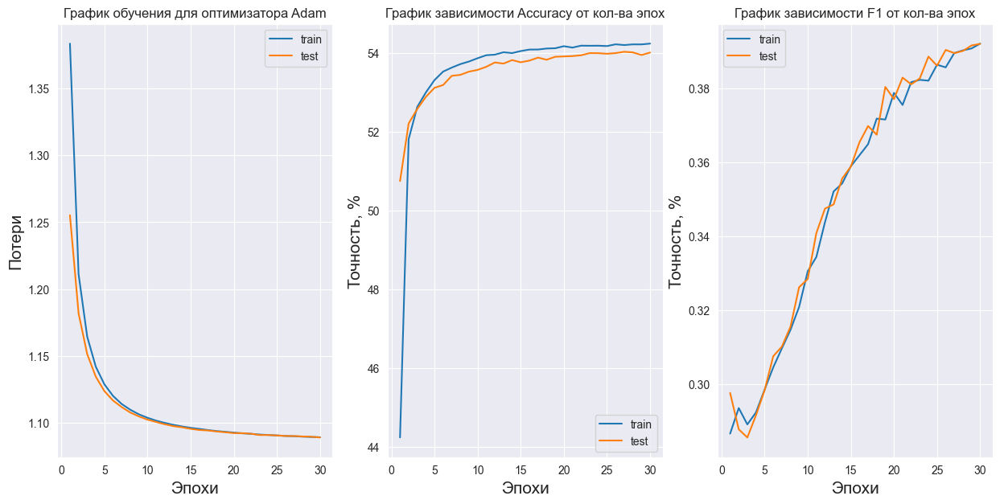

In [89]:
plt.figure(figsize=(15, 7))
plt.subplot(1, 3, 1)
plt.plot(range(1, num_epochs + 1), loss_history["train"], label="train")
plt.plot(range(1, num_epochs + 1), loss_history["test"], label="test")
plt.xlabel("Эпохи", fontsize=15)
plt.ylabel("Потери", fontsize=15)
plt.title("График обучения для оптимизатора Adam")
plt.legend()
plt.subplot(1, 3, 2)
plt.plot(range(1, num_epochs + 1), cor_train_g, label="train")
plt.plot(range(1, num_epochs + 1), cor_test_g, label="test")
plt.xlabel("Эпохи", fontsize=15)
plt.ylabel("Точность, %", fontsize=15)
plt.legend()
plt.title("График зависимости Accuracy от кол-ва эпох")
plt.subplot(1, 3, 3)
plt.plot(range(1, num_epochs + 1), f1_train, label="train")
plt.plot(range(1, num_epochs + 1), f1_test, label="test")
plt.xlabel("Эпохи", fontsize=15)
plt.ylabel("Точность, %", fontsize=15)
plt.legend()
plt.title("График зависимости F1 от кол-ва эпох")
plt.grid
plt.show()

In [90]:
y_pred = []
y_true = []
correct = 0
total = 0
with torch.no_grad():
    for data in dataloader_test:
        X, y = data
        output = model(X.to(device))
        y_true += y.tolist()
        y_pred += torch.argmax(output, dim=1).tolist()
        for idx, i in enumerate(output):
             if torch.argmax(i) == y[idx]:
                 correct += 1
             total += 1
print(f'Accuracy: {round(accuracy_score(y_true, y_pred)*100, 2)}%')
print(f'Precision score: {round(precision_score(y_true, y_pred, average="macro")*100, 2)}%')
print(f'Recall score: {round(recall_score(y_true, y_pred, average="macro")*100, 2)}%')
print(f'f1 score: {round(f1_score(y_true, y_pred, average="macro")*100, 2)}%')

Accuracy: 54.01%
Precision score: 55.58%
Recall score: 35.55%
f1 score: 39.2%


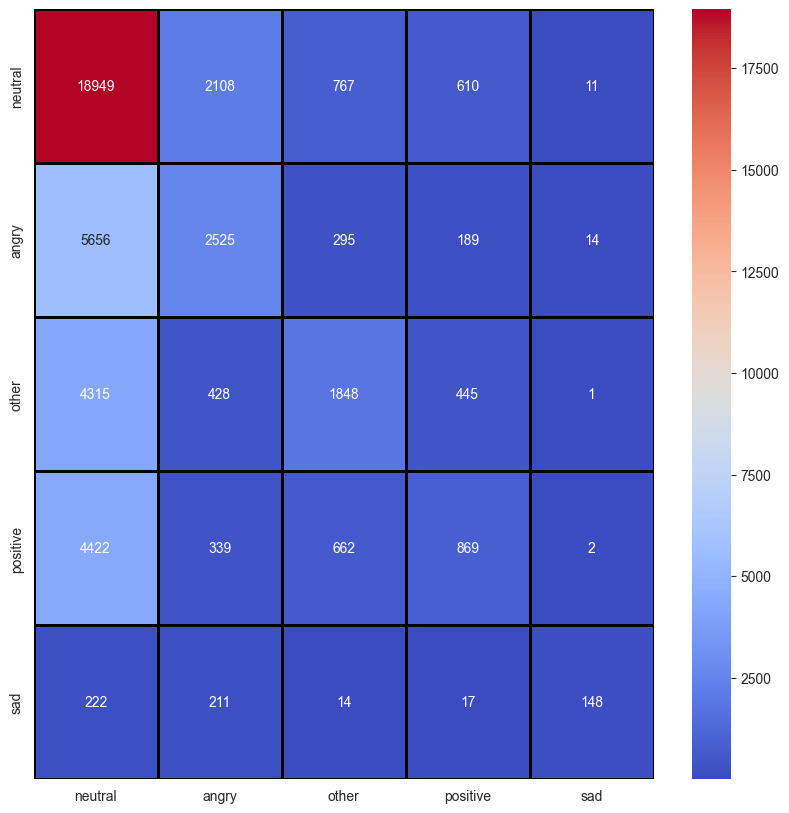

In [91]:
plt.figure(figsize=(10,10))
sns.heatmap(confusion_matrix(y_true, y_pred), annot=True, cmap='coolwarm', linewidths=2, linecolor='black',fmt=str(), xticklabels=train_features.label.unique(), yticklabels=train_features.label.unique())
plt.show()

In [93]:
print(classification_report(y_true, y_pred))

              precision    recall  f1-score   support

           0       0.56      0.84      0.68     22445
           1       0.45      0.29      0.35      8679
           2       0.52      0.26      0.35      7037
           3       0.41      0.14      0.21      6294
           4       0.84      0.24      0.38       612

    accuracy                           0.54     45067
   macro avg       0.56      0.36      0.39     45067
weighted avg       0.52      0.54      0.49     45067



### конец ненужного куска


## KNN

In [57]:
X = train_features[train_features.columns.drop(['label','audio_path', 'dataset'])]
y = pd.DataFrame(train_features[train_features.columns[-2]])
X = preprocessing.StandardScaler().fit(X).transform(X)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.28, random_state=123)

In [58]:
dic = {'neutral':0, 'sad':1, 'positive':2, 'angry':3, 'other':4}
y_train = y_train['label'].map(dic)
y_train.dropna(inplace=True)
y_test = y_test['label'].map(dic)
y_test.dropna(inplace=True)
y_train = y_train.to_numpy()
y_test = y_test.to_numpy()

In [59]:
X_train = torch.from_numpy(X_train).float()
X_test = torch.from_numpy(X_test).float()
y_train = torch.from_numpy(y_train).long()
y_test = torch.from_numpy(y_test).long()
# Create a PyTorch dataset and dataloader
dataset_train = TensorDataset(X_train, y_train)
dataloader_train = DataLoader(dataset_train, batch_size=32, shuffle=True)
dataset_test = TensorDataset(X_test, y_test)
dataloader_test = DataLoader(dataset_test, batch_size=32, shuffle=True)


In [60]:
def knn(sample, X, y, k_neighbors):
    """Instance of K-Nearest Neigbhors model

    Args:
        X: A torch tensor for the data.
        y: A torch tensor for the labels.
        k_neighbors: An integer for the number of nearest neighbors
            to consider.
    """
    sample = sample.to(device).unsqueeze(1).T
    # Compute the distance with the train set
    dist = (X - sample).pow(2).sum(axis=1).sqrt()

    # Sort the distances
    _, indices = torch.sort(dist)
    y = y[indices]

    # Get the Kth most similar samples and return the predominant class
    return y[:k_neighbors].bincount().argmax().item()

import torch

def knn_cosine(sample, X, y, k_neighbors):
    """Instance of K-Nearest Neigbhors model
    Args:
        X: A torch tensor for the data.
        y: A torch tensor for the labels.
        k_neighbors: An integer for the number of nearest neighbors to consider.
    """
    sample = sample.to(device).unsqueeze(1).T

    # Вычисляем косинусное расстояние с обучающим набором данных
    cos_sim = torch.nn.functional.cosine_similarity(X, sample, dim=1)

    # Сортируем косинусные расстояния в порядке убывания
    _, indices = torch.sort(cos_sim, descending=True)

    y = y[indices]

    # Получаем K наиболее похожих образцов и возвращаем преобладающий класс
    return y[:k_neighbors].bincount().argmax().item()

def train_knn(X_train, X_test, y_train, y_test, func, k_neighbors):
    """Trains a K-Nearest Neigbhors model

    Args:
        X_train: A torch tensor for the training data.
        X_test: A torch tensor for the test data.
        y_train: A torch tensor for the training labels.
        y_test: A torch tensor for the test labels.
        k_neighbors: An integer for the number of nearest neighbors
            to consider.
    """
    y_test = y_test.to(device)
    y_train = y_train.to(device)
    X_train = X_train.to(device)
    X_test = X_test.to(device)
    # Allocate space for the prediction
    y_pred_test = np.zeros(y_test.shape, dtype=np.uint8)
    y_pred_train = np.zeros(y_train.shape, dtype=np.uint8)
    X_train_c = X_train.clone()

    # Predict on each sample of the train and test
    for i in range(X_test.shape[0]):
        y_pred_test[i] = func(X_test[i], X_train, y_train, k_neighbors=k_neighbors)
    y_pred_test = torch.from_numpy(y_pred_test).float()
    return y_pred_test

In [61]:
knn_euq = {}
knn_cos = {}
for s in range(5,13):
    pred_test = train_knn(X_train, X_test, y_train, y_test, knn, k_neighbors=s)
    knn_euq[s]= round(f1_score(y_test, pred_test, average="macro")*100, 2)
    pred_test = train_knn(X_train, X_test, y_train, y_test, knn_cosine, k_neighbors=s)
    knn_cos[s]= round(f1_score(y_test, pred_test, average="macro")*100, 2)


In [62]:
knn_euq

{5: 50.86,
 6: 50.01,
 7: 50.92,
 8: 50.47,
 9: 50.9,
 10: 50.64,
 11: 50.67,
 12: 50.61}

In [63]:
knn_cos

{5: 50.81,
 6: 50.35,
 7: 51.24,
 8: 50.72,
 9: 51.04,
 10: 50.83,
 11: 50.64,
 12: 50.43}

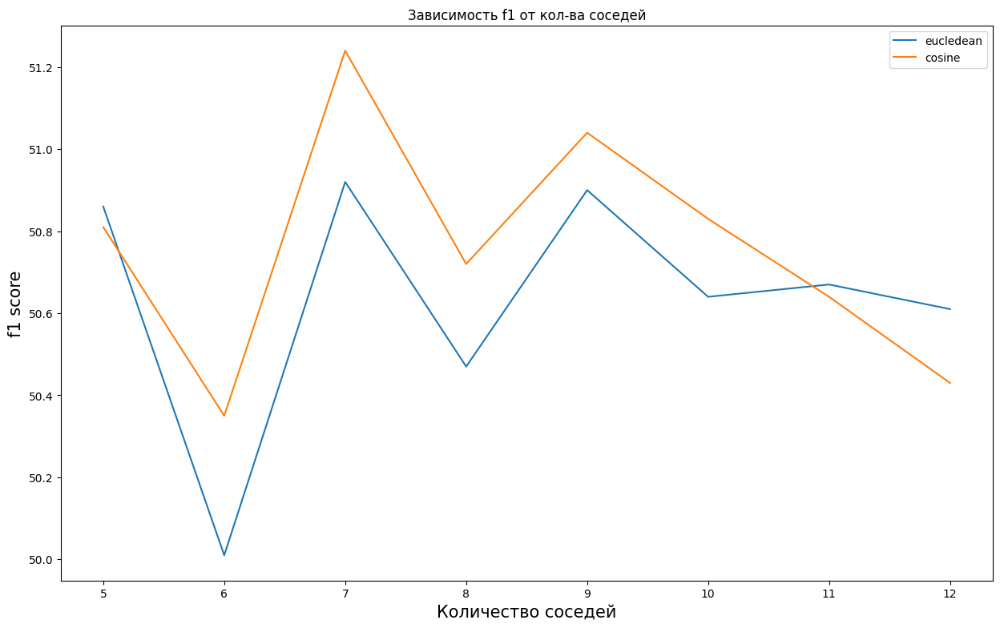

In [70]:
plt.figure(figsize=(15, 9))
plt.plot(knn_euq.keys(), knn_euq.values(), label="eucledean")
plt.plot(knn_cos.keys(), knn_cos.values(), label="cosine")
plt.xlabel("Количество соседей", fontsize=15)
plt.ylabel("f1 score", fontsize=15)
plt.title("Зависимость f1 от кол-ва соседей")
plt.legend()


In [71]:
pred_test = train_knn(X_train, X_test, y_train, y_test, knn, k_neighbors=9)
print(f'Accuracy: {round(accuracy_score(y_test, pred_test)*100, 2)}%')
print(f'Precision score: {round(precision_score(y_test, pred_test, average="macro")*100, 2)}%')
print(f'Recall score: {round(recall_score(y_test, pred_test, average="macro")*100, 2)}%')
print(f'f1 score: {round(f1_score(y_test, pred_test, average="macro")*100, 2)}%')
print(classification_report(y_test, pred_test))

Accuracy: 60.68%
Precision score: 55.97%
Recall score: 48.85%
f1 score: 50.9%
              precision    recall  f1-score   support

           0       0.64      0.82      0.72     22367
           1       0.57      0.50      0.53      8694
           2       0.52      0.33      0.40      7111
           3       0.51      0.30      0.38      6286

    accuracy                           0.61     44458
   macro avg       0.56      0.49      0.51     44458
weighted avg       0.59      0.61      0.59     44458



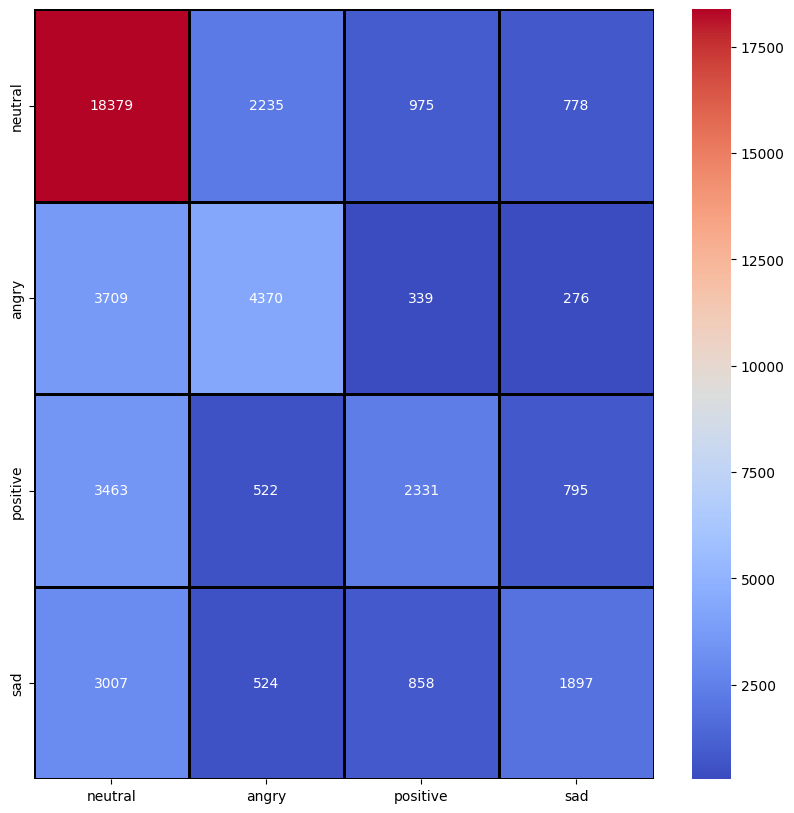

In [72]:
plt.figure(figsize=(10,10))
sns.heatmap(confusion_matrix(y_test, pred_test), annot=True, cmap='coolwarm', linewidths=2, linecolor='black',fmt=str(), xticklabels=train_features.label.unique(), yticklabels=train_features.label.unique())
plt.show()

In [93]:
tf = train_features.sample(n=30000)
print(tf.label.value_counts())


label
neutral     15062
sad          5797
positive     4828
angry        4313
Name: count, dtype: int64


In [94]:
X = tf[tf.columns.drop(['label', 'audio_path', 'dataset'])]
y = pd.DataFrame(tf[tf.columns[-2]])
X = preprocessing.StandardScaler().fit(X).transform(X)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.28, random_state=123)


In [95]:
dic = {'neutral': 0, 'sad': 1, 'positive': 2, 'angry': 3}
y_train = y_train['label'].map(dic)
y_train.dropna(inplace=True)
y_test = y_test['label'].map(dic)
y_test.dropna(inplace=True)
y_train = y_train.to_numpy()
y_test = y_test.to_numpy()

In [96]:
params_grid = [{'weights': ['distance', 'uniform'], 'metric': ['cosine'], 'leaf_size': [20, 30, 15]}]
knn_model = GridSearchCV(KNeighborsClassifier(), params_grid, cv=5, verbose=2, n_jobs=-1)
knn_model.fit(X_train, y_train)


Fitting 5 folds for each of 6 candidates, totalling 30 fits


GridSearchCV(cv=5, estimator=KNeighborsClassifier(), n_jobs=-1,
             param_grid=[{'leaf_size': [20, 30, 15], 'metric': ['cosine'],
                          'weights': ['distance', 'uniform']}],
             verbose=2)

In [97]:
final_model = knn_model.best_estimator_
y_pred = final_model.predict(X_test)


In [98]:
print(confusion_matrix(y_test, y_pred))
print("\n")
print(classification_report(y_test, y_pred))

print("Training set score for SVM: %f" % final_model.score(X_train, y_train))
print("Testing  set score for SVM: %f" % final_model.score(X_test, y_test))

knn_model.score

[[3359  489  214  113]
 [ 832  671   95   46]
 [ 761  127  377   97]
 [ 663  154  191  211]]


              precision    recall  f1-score   support

           0       0.60      0.80      0.69      4175
           1       0.47      0.41      0.44      1644
           2       0.43      0.28      0.34      1362
           3       0.45      0.17      0.25      1219

    accuracy                           0.55      8400
   macro avg       0.49      0.42      0.43      8400
weighted avg       0.52      0.55      0.52      8400

Training set score for SVM: 0.679213
Testing  set score for SVM: 0.549762


<bound method BaseSearchCV.score of GridSearchCV(cv=5, estimator=KNeighborsClassifier(), n_jobs=-1,
             param_grid=[{'leaf_size': [20, 30, 15], 'metric': ['cosine'],
                          'weights': ['distance', 'uniform']}],
             verbose=2)>

In [101]:
print(f'Accuracy: {round(accuracy_score(y_test, y_pred)*100, 2)}%')
print(f'Precision score: {round(precision_score(y_test, y_pred, average="macro")*100, 2)}%')
print(f'Recall score: {round(recall_score(y_test, y_pred, average="macro")*100, 2)}%')
print(f'f1 score: {round(f1_score(y_test, y_pred, average="macro")*100, 2)}%')

Accuracy: 54.98%
Precision score: 48.64%
Recall score: 41.56%
f1 score: 42.71%


## Catboost

In [15]:
tf = train_features.sample(n=35000)
print(tf.label.value_counts())

X = tf[tf.columns.drop(['label', 'audio_path', 'dataset'])]
y = pd.DataFrame(tf[tf.columns[-2]])
X = preprocessing.StandardScaler().fit(X).transform(X)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, stratify=tf['label'], random_state=123)




label
neutral     17663
sad          6859
positive     5491
angry        4987
Name: count, dtype: int64


In [16]:
dic = {'neutral': 0, 'sad': 1, 'positive': 2, 'angry': 3}
y_train = y_train['label'].map(dic)
y_train.dropna(inplace=True)
y_test = y_test['label'].map(dic)
y_test.dropna(inplace=True)
y_train = y_train.to_numpy()
y_test = y_test.to_numpy()

In [17]:
from sklearn.model_selection import StratifiedKFold

# Define the search space
param_grid = {"iterations":[400, 450, 350],
              'grow_policy': ['Lossguide'],
              'bootstrap_type': ['Poisson','Bernoulli','MVS','Poisson'],
              'sampling_frequency': ['PerTree','PerTreeLevel'],
              'min_data_in_leaf': [4, 3, 5],
              'subsample': [0.15, 0.1, 0.05],
              'leaf_estimation_method': ['Gradient', 'Newton', 'Exact'],
              "learning_rate": [0.01, 0.1],
              "depth": range(3, 9),
              'random_strength': [0.5, 1, 1.5],
              "reg_lambda": [1, 0.1, 0.5],
              'auto_class_weights': ['Balanced']}
# Set up the k-fold cross-validation
kfold = StratifiedKFold(n_splits=3, shuffle=True, random_state=123)

In [18]:
ct= catboost.CatBoostClassifier(task_type="GPU",loss_function='MultiClass', eval_metric='MultiClass')
# 'loss_function':['MultiClass','MultiClassOneVsAll','TotalF1' MultiLogloss MultiCrossEntropy]
# eval'MultiClass', 'TotalF1', 'MultiCrossEntropy', 'MultiLogloss' ?
random_search = ct.randomized_search(param_distributions=param_grid,
                                     X=X_train,
                                     y=y_train,
                                     cv=kfold,
                                     n_iter=2500,
                                     verbose=1,
                                     plot=True)

print("best params:\n", random_search['params'])

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 1.3862850	test: 1.3862964	best: 1.3862964 (0)	total: 132ms	remaining: 52.8s
1:	learn: 1.3862762	test: 1.3862983	best: 1.3862964 (0)	total: 135ms	remaining: 26.8s
2:	learn: 1.3862669	test: 1.3863001	best: 1.3862964 (0)	total: 137ms	remaining: 18.1s
3:	learn: 1.3862580	test: 1.3863024	best: 1.3862964 (0)	total: 140ms	remaining: 13.8s
4:	learn: 1.3862493	test: 1.3863045	best: 1.3862964 (0)	total: 142ms	remaining: 11.2s
5:	learn: 1.3862410	test: 1.3863067	best: 1.3862964 (0)	total: 143ms	remaining: 9.42s
6:	learn: 1.3862326	test: 1.3863091	best: 1.3862964 (0)	total: 145ms	remaining: 8.15s
7:	learn: 1.3862242	test: 1.3863113	best: 1.3862964 (0)	total: 147ms	remaining: 7.2s
8:	learn: 1.3862166	test: 1.3863138	best: 1.3862964 (0)	total: 150ms	remaining: 6.51s
9:	learn: 1.3862081	test: 1.3863162	best: 1.3862964 (0)	total: 153ms	remaining: 5.96s
10:	learn: 1.3862004	test: 1.3863186	best: 1.3862964 (0)	total: 156ms	remaining: 5.5s
11:	learn: 1.3861928	test: 1.3863212	best: 1.3862964 (0

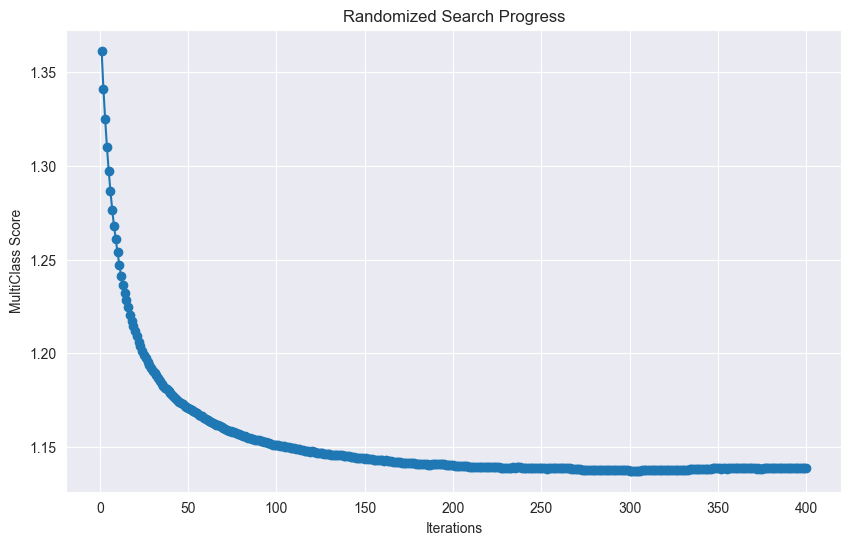

In [19]:
results = random_search['cv_results']
iterations = list(range(1, len(results['test-MultiClass-mean']) + 1))
scores = results['test-MultiClass-mean']

# Построить график
plt.figure(figsize=(10, 6))
plt.plot(iterations, scores, marker='o')
plt.xlabel('Iterations')
plt.ylabel('MultiClass Score')
plt.title('Randomized Search Progress')
plt.grid(True)
plt.show()

In [20]:
X = train_features[train_features.columns.drop(['label', 'audio_path', 'dataset'])]
y = pd.DataFrame(train_features[train_features.columns[-2]])
X = preprocessing.StandardScaler().fit(X).transform(X)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.28, random_state=123)


dic = {'neutral': 0, 'sad': 1, 'positive': 2, 'angry': 3, 'other': 4}
y_train = y_train['label'].map(dic)
y_train.dropna(inplace=True)
y_test = y_test['label'].map(dic)
y_test.dropna(inplace=True)
y_train = y_train.to_numpy()
y_test = y_test.to_numpy()


In [22]:
best_params = random_search['params']

best_model = catboost.CatBoostClassifier(task_type="GPU", loss_function='MultiClass', eval_metric='MultiClass', **best_params)

best_model.fit(X_train, y_train)

# Предсказание на тестовом наборе данных
y_pred = best_model.predict(X_test)

accuracy = accuracy_score(y_test, y_pred)
print("Точность модели: {:.2f}".format(accuracy))
print("\n")
print(classification_report(y_test, y_pred))

0:	learn: 1.3603440	total: 9.99ms	remaining: 3.99s
1:	learn: 1.3390487	total: 20.1ms	remaining: 4s
2:	learn: 1.3212017	total: 30ms	remaining: 3.96s
3:	learn: 1.3061515	total: 41.3ms	remaining: 4.09s
4:	learn: 1.2922895	total: 52.6ms	remaining: 4.16s
5:	learn: 1.2809364	total: 62.8ms	remaining: 4.12s
6:	learn: 1.2705896	total: 73.3ms	remaining: 4.11s
7:	learn: 1.2610523	total: 83.8ms	remaining: 4.1s
8:	learn: 1.2523462	total: 95.1ms	remaining: 4.13s
9:	learn: 1.2447783	total: 106ms	remaining: 4.13s
10:	learn: 1.2381263	total: 118ms	remaining: 4.16s
11:	learn: 1.2320102	total: 145ms	remaining: 4.7s
12:	learn: 1.2261898	total: 156ms	remaining: 4.65s
13:	learn: 1.2209059	total: 166ms	remaining: 4.57s
14:	learn: 1.2162880	total: 175ms	remaining: 4.48s
15:	learn: 1.2114452	total: 182ms	remaining: 4.37s
16:	learn: 1.2077567	total: 191ms	remaining: 4.31s
17:	learn: 1.2035299	total: 201ms	remaining: 4.27s
18:	learn: 1.2000197	total: 211ms	remaining: 4.24s
19:	learn: 1.1963059	total: 223ms	remai

## MLP

In [110]:
X = train_features[train_features.columns.drop(['label', 'audio_path', 'dataset'])]
y = pd.DataFrame(train_features[train_features.columns[-2]])
X = preprocessing.StandardScaler().fit(X).transform(X)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.28, random_state=123)


dic = {'neutral': 0, 'sad': 1, 'positive': 2, 'angry': 3, 'other': 4}
y_train = y_train['label'].map(dic)
y_train.dropna(inplace=True)
y_test = y_test['label'].map(dic)
y_test.dropna(inplace=True)
y_train = y_train.to_numpy()
y_test = y_test.to_numpy()
# Convert the data to PyTorch tensors
X_train = torch.from_numpy(X_train).float()
X_test = torch.from_numpy(X_test).float()
y_train = torch.from_numpy(y_train).long()
y_test = torch.from_numpy(y_test).long()
# Create a PyTorch dataset and dataloader
dataset_train = TensorDataset(X_train, y_train)
dataloader_train = DataLoader(dataset_train, batch_size=128, shuffle=True)
dataset_test = TensorDataset(X_test, y_test)
dataloader_test = DataLoader(dataset_test, batch_size=128, shuffle=True)

In [111]:
class Net_mlp(nn.Module):
    def __init__(self):
        super().__init__()
        self.flatten = nn.Flatten()
        self.layers_stack = nn.Sequential(
            nn.Linear(45, 512),
            nn.LeakyReLU(),
            nn.Linear(512, 256),
            nn.BatchNorm1d(256),
            nn.LeakyReLU(),
            nn.Linear(256, 128),
            nn.BatchNorm1d(128),
            nn.LeakyReLU(),
            nn.Linear(128, 64),
            nn.LeakyReLU(),
            nn.Linear(64, 4),
        )

    def forward(self, x):
        x = self.flatten(x)
        logits = self.layers_stack(x)
        return logits

In [112]:
learning_rate = 1e-3
device = "cuda" if torch.cuda.is_available() else "cpu"
print(f"Using {device} device")
model = Net_mlp().to(device)
loss_function = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=learning_rate)

Using cuda device


In [113]:
def train_loop(dataloader, model, loss_function, optimizer):
    global cortrain
    num_batches = len(dataloader)

    train_loss, corr_train = 0, 0
    cortrain = []

    for x, y in dataloader:
        x, y = batch
        x, y = x.cuda(), y.cuda()
        # предсказание и расчет потерь
        pred = model(x)
        loss = loss_function(pred, y)

        # оптимизация
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        train_loss += loss.item()
        corr_train += (
                (pred.argmax(1) == y).type(torch.float).sum().item()
            )
    cortrain = corr_train* 100
    train_loss /= num_batches
    print(f"Потери обучения: {train_loss:>8f}")

    return train_loss


def test_loop(dataloader, model, loss_function):
    global cortest
    size = len(dataloader.dataset)
    num_batches = len(dataloader)

    test_loss, correct = 0, 0
    cortest = []
    with torch.no_grad():
        for x, y in dataloader:
            # Compute prediction and loss
            pred = model(x.to(device))
            loss = loss_function(pred, y.to(device))

            test_loss += loss.item()
            correct += (
                (pred.argmax(1) == y.to(device)).type(torch.float).sum().item()
            )
    cortest = correct * 100
    test_loss /= num_batches
    correct /= size
    print(f"Потери на тестовых данных: {test_loss:>8f}, Точность модели на тестовых данных: {(100*correct):>0.1f}% \n")

    return test_loss

In [114]:
loss_history = {"train": [], "test": []}
start_time = time.time()
num_epochs = 7
cor_test = []
cor_train = []
for i in range(num_epochs):
    print(f"Эпоха номер {i+1}")
    train_loss = train_loop(dataloader_train, model, loss_function, optimizer)
    test_loss = test_loop(dataloader_test, model, loss_function)
    cor_test.append(cortest)
    cor_train.append(cortrain)
    loss_history["train"].append(train_loss)
    loss_history["test"].append(test_loss)
print(f"Обучение завершнео за {num_epochs} эпох, затраченное время: {round(time.time() - start_time, 3)} секунд")

Эпоха номер 1
Потери обучения: 0.014392
Потери на тестовых данных: 3.923642, Точность модели на тестовых данных: 37.9% 

Эпоха номер 2
Потери обучения: 0.000018
Потери на тестовых данных: 4.369622, Точность модели на тестовых данных: 37.7% 

Эпоха номер 3
Потери обучения: 0.000006
Потери на тестовых данных: 4.662584, Точность модели на тестовых данных: 37.7% 

Эпоха номер 4
Потери обучения: 0.000003
Потери на тестовых данных: 4.902708, Точность модели на тестовых данных: 37.5% 

Эпоха номер 5
Потери обучения: 0.000001
Потери на тестовых данных: 5.099098, Точность модели на тестовых данных: 37.6% 

Эпоха номер 6
Потери обучения: 0.000001
Потери на тестовых данных: 5.294015, Точность модели на тестовых данных: 37.5% 

Эпоха номер 7
Потери обучения: 0.000000
Потери на тестовых данных: 5.469402, Точность модели на тестовых данных: 37.7% 

Обучение завершнео за 7 эпох, затраченное время: 19.851 секунд


## LSTM

In [26]:
X = train_features[train_features.columns.drop(['label', 'audio_path', 'dataset'])]
y = pd.DataFrame(train_features[train_features.columns[-2]])
X = preprocessing.StandardScaler().fit(X).transform(X)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.28, random_state=123)


dic = {'neutral': 0, 'sad': 1, 'positive': 2, 'angry': 3, 'other': 4}
y_train = y_train['label'].map(dic)
y_train.dropna(inplace=True)
y_test = y_test['label'].map(dic)
y_test.dropna(inplace=True)
y_train = y_train.to_numpy()
y_test = y_test.to_numpy()
# Convert the data to PyTorch tensors
X_train = torch.from_numpy(X_train).float()
X_test = torch.from_numpy(X_test).float()
y_train = torch.from_numpy(y_train).long()
y_test = torch.from_numpy(y_test).long()
# Create a PyTorch dataset and dataloader
dataset_train = TensorDataset(X_train, y_train)
dataloader_train = DataLoader(dataset_train, batch_size=64, shuffle=True)
dataset_test = TensorDataset(X_test, y_test)
dataloader_test = DataLoader(dataset_test, batch_size=64, shuffle=True)

In [27]:
# Define the SVM model
class LSTMClassifier(nn.Module):
    def __init__(self, input_dim, hidden_dim, output_dim):
        super(LSTMClassifier, self).__init__()
        self.rnn = nn.LSTM(input_dim, hidden_dim)
        self.fc = nn.Linear(hidden_dim, output_dim)
        self.hidden_dim = hidden_dim

    def init_hidden(self, bs):
        return torch.zeros(1, bs, self.hidden_dim), torch.zeros(1, bs, self.hidden_dim)

    def forward(self, X, hidden, cell):
        out = X.unsqueeze(0)
        out, (hidden, cell) = self.rnn(out, (hidden, cell))
        out = hidden[-1, :, :]
        out = torch.log_softmax(self.fc(out), dim=1)
        return out, (hidden, cell)


# Create an instance of the SVM model
model = LSTMClassifier(input_dim=45, hidden_dim=512, output_dim=4)

# Move the model and data to GPU if available

model.to(device)
X_test = X_test.to(device)
loss_function = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)


In [28]:
from tqdm import tqdm
def accuracy(y_pred, y_acc):
    with torch.no_grad():
        return torch.sum(torch.max(torch.exp(y_pred), dim=1)[1] == y_acc).item() / len(y_acc)
def f1_f(y_pred, y_true):
    with torch.no_grad():
        y_pred = torch.max(torch.exp(y_pred), dim=1)[1].cpu().numpy()
        y_true = y_true.cpu().numpy()
        return f1_score(y_true, y_pred, average='weighted')



In [29]:
epochs = 10
for e in range(1, epochs + 1):
    train_loss = 0
    train_acc = 0
    train_f1 = 0

    model.train()
    for batch in tqdm(dataloader_train, leave=True):
        x, y = batch
        x, y = x.cuda(), y.cuda()

        # Initialize the hidden state
        (hidden, cell) = model.init_hidden(x.size(0))
        hidden = hidden.to(device)
        cell = cell.to(device)

        # Forward pass and backprop
        out, (hidden, cell) = model(x, hidden, cell)
        loss = loss_function(out, y)
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        train_loss += loss.item()
        train_acc += accuracy(out, y)
        train_f1 += f1_f(out, y)

    # Scale accuracy and losses
    train_loss /= len(dataloader_train)
    train_acc /= len(dataloader_train)
    train_f1 /= len(dataloader_train)

    test_loss = 0
    test_acc = 0
    test_f1 = 0

    model.eval()
    with torch.no_grad():
        for batch in tqdm(dataloader_test, leave=True):
            x, y = batch
            x, y = x.cuda(), y.cuda()
            (hidden, cell) = model.init_hidden(x.size(0))
            hidden = hidden.to(device)
            cell = cell.to(device)

            out, (hidden, cell) = model(x, hidden, cell)
            loss = loss_function(out, y)

            test_loss += loss.item()
            test_acc += accuracy(out, y)
            test_f1 += f1_f(out, y)

    test_loss /= len(dataloader_test)
    test_acc /= len(dataloader_test)
    test_f1 /= len(dataloader_test)

    print("Epoch {:4} | Train Loss {:.4f} | Train Acc {:.4f} | Train F1 {:.4f} | Test Loss {:.4f} | Test Acc {:.4f} | Test F1 {:.4f}".format(e, train_loss, train_acc, train_f1, test_loss, test_acc, test_f1))

100%|██████████| 695/695 [00:01<00:00, 622.03it/s]


Epoch    1 | Train Loss 1.0358 | Train Acc 0.5577 | Train F1 0.5154 | Test Loss 1.0194 | Test Acc 0.5638 | Test F1 0.5163


100%|██████████| 695/695 [00:01<00:00, 590.15it/s]


Epoch    2 | Train Loss 0.9985 | Train Acc 0.5733 | Train F1 0.5406 | Test Loss 1.0047 | Test Acc 0.5725 | Test F1 0.5440


100%|██████████| 695/695 [00:01<00:00, 632.72it/s]


Epoch    3 | Train Loss 0.9781 | Train Acc 0.5858 | Train F1 0.5577 | Test Loss 0.9849 | Test Acc 0.5802 | Test F1 0.5542


100%|██████████| 695/695 [00:01<00:00, 590.94it/s]


Epoch    4 | Train Loss 0.9591 | Train Acc 0.5971 | Train F1 0.5714 | Test Loss 0.9752 | Test Acc 0.5873 | Test F1 0.5579


100%|██████████| 695/695 [00:01<00:00, 589.72it/s]


Epoch    5 | Train Loss 0.9424 | Train Acc 0.6050 | Train F1 0.5822 | Test Loss 0.9661 | Test Acc 0.5948 | Test F1 0.5705


100%|██████████| 695/695 [00:01<00:00, 582.71it/s]


Epoch    6 | Train Loss 0.9255 | Train Acc 0.6144 | Train F1 0.5938 | Test Loss 0.9614 | Test Acc 0.5938 | Test F1 0.5726


100%|██████████| 695/695 [00:01<00:00, 410.79it/s]


Epoch    7 | Train Loss 0.9087 | Train Acc 0.6221 | Train F1 0.6031 | Test Loss 0.9554 | Test Acc 0.5974 | Test F1 0.5788


100%|██████████| 695/695 [00:01<00:00, 563.62it/s]


Epoch    8 | Train Loss 0.8925 | Train Acc 0.6289 | Train F1 0.6113 | Test Loss 0.9555 | Test Acc 0.5995 | Test F1 0.5806


100%|██████████| 695/695 [00:01<00:00, 466.46it/s]


Epoch    9 | Train Loss 0.8758 | Train Acc 0.6366 | Train F1 0.6202 | Test Loss 0.9543 | Test Acc 0.6002 | Test F1 0.5865


100%|██████████| 695/695 [00:01<00:00, 618.25it/s]

Epoch   10 | Train Loss 0.8586 | Train Acc 0.6450 | Train F1 0.6302 | Test Loss 0.9574 | Test Acc 0.6012 | Test F1 0.5790


In [73]:
X = train_features[train_features.columns.drop(['label', 'audio_path', 'dataset'])]
y = pd.DataFrame(train_features[train_features.columns[-2]])
X = preprocessing.StandardScaler().fit(X).transform(X)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.28, random_state=123)


dic = {'neutral': 0, 'sad': 1, 'positive': 2, 'angry': 3, 'other': 4}
y_train = y_train['label'].map(dic)
y_train.dropna(inplace=True)
y_test = y_test['label'].map(dic)
y_test.dropna(inplace=True)
y_train = y_train.to_numpy()
y_test = y_test.to_numpy()
# Convert the data to PyTorch tensors
X_train = torch.from_numpy(X_train).float()
X_test = torch.from_numpy(X_test).float()
y_train = torch.from_numpy(y_train).long()
y_test = torch.from_numpy(y_test).long()
# Create a PyTorch dataset and dataloader
dataset_train = TensorDataset(X_train, y_train)
dataloader_train = DataLoader(dataset_train, batch_size=128, shuffle=True)
dataset_test = TensorDataset(X_test, y_test)
dataloader_test = DataLoader(dataset_test, batch_size=128, shuffle=True)

In [74]:
class VariableHiddenDimLSTM(nn.Module):
    def __init__(self, input_dim, hidden_dims, output_dim):
        super(VariableHiddenDimLSTM, self).__init__()
        self.num_layers = len(hidden_dims)
        self.lstm_layers = nn.ModuleList()
        #self.dropout_layers = nn.ModuleList()


        self.lstm_layers.append(nn.LSTM(input_dim, hidden_dims[0]))
        #self.dropout_layers.append(nn.Dropout(0.9))  # Пример добавления слоя Dropout


        for i in range(1, self.num_layers):
            self.lstm_layers.append(nn.LSTM(hidden_dims[i-1], hidden_dims[i]))
            #self.dropout_layers.append(nn.Dropout(0.7))  # Пример добавления слоя Dropout


        self.fc = nn.Linear(hidden_dims[-1], output_dim)
        self.hidden_dims = hidden_dims

    def init_hidden(self, bs):
        hidden = []
        for i in range(self.num_layers):
            hidden.append((torch.zeros(1, bs, self.hidden_dims[i]), torch.zeros(1, bs, self.hidden_dims[i])))
        return hidden

    def forward(self, X, hidden):
        out = X.unsqueeze(0)
        for i in range(self.num_layers):
            out, hidden[i] = self.lstm_layers[i](out, hidden[i])
            #out = self.dropout_layers[i](out)  # Применение Dropout
        out = out.squeeze(0)
        out = torch.log_softmax(self.fc(out), dim=1)
        return out, hidden


# Create an instance of the SVM model
model = VariableHiddenDimLSTM(input_dim=45, hidden_dims=[2048, 1024, 512, 256], output_dim=4)

# Move the model and data to GPU if available

model.to(device)
X_test = X_test.to(device)
loss_function = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

In [75]:
%%time
epochs = 10
trf1 = []
tsf1 =[]
tsa=[]
tra=[]
trls = []
tsls = []
for e in range(1, epochs + 1):
    train_loss = 0
    train_acc = 0
    train_f1 = 0
    model.train()
    for batch in tqdm(dataloader_train, leave=True):
        x, y = batch
        x, y = x.cuda(), y.cuda()

        # Initialize the hidden state for each layer
        hidden = model.init_hidden(x.size(0))
        for i in range(len(hidden)):
            hidden[i] = (hidden[i][0].to(device), hidden[i][1].to(device))

        # Forward pass and backprop
        out, hidden = model(x, hidden)
        loss = loss_function(out, y)
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        train_loss += loss.item()
        train_acc += accuracy(out, y)
        train_f1 += f1_f(out, y)

    # Scale accuracy and losses
    train_loss /= len(dataloader_train)
    train_acc /= len(dataloader_train)
    train_f1 /= len(dataloader_train)

    test_loss = 0
    test_acc = 0
    test_f1 = 0

    with torch.no_grad():
        for batch in tqdm(dataloader_test, leave=True):
            x, y = batch
            x, y = x.cuda(), y.cuda()

            hidden = model.init_hidden(x.size(0))
            for i in range(len(hidden)):
                hidden[i] = (hidden[i][0].to(device), hidden[i][1].to(device))

            out, hidden = model(x, hidden)
            loss = loss_function(out, y)

            test_loss += loss.item()
            test_acc += accuracy(out, y)
            test_f1 += f1_f(out, y)

    test_loss /= len(dataloader_test)
    test_acc /= len(dataloader_test)
    test_f1 /= len(dataloader_test)
    trf1.append(train_f1)
    tsf1.append(test_f1)
    tsa.append(test_acc)
    tra.append(train_acc)
    trls.append(train_loss)
    tsls.append(test_loss)

    print("Epoch {:4} | Train Loss {:.4f} | Train Acc {:.4f} | Train F1 {:.4f} | Test Loss {:.4f} | Test Acc {:.4f} | Test F1 {:.4f}".format(e, train_loss, train_acc, train_f1, test_loss, test_acc, test_f1))

100%|██████████| 348/348 [00:01<00:00, 293.51it/s]


Epoch    1 | Train Loss 1.0470 | Train Acc 0.5488 | Train F1 0.5058 | Test Loss 1.0228 | Test Acc 0.5618 | Test F1 0.5310


100%|██████████| 348/348 [00:01<00:00, 328.21it/s]


Epoch    2 | Train Loss 1.0008 | Train Acc 0.5737 | Train F1 0.5454 | Test Loss 1.0003 | Test Acc 0.5701 | Test F1 0.5253


100%|██████████| 348/348 [00:00<00:00, 354.04it/s]


Epoch    3 | Train Loss 0.9696 | Train Acc 0.5888 | Train F1 0.5645 | Test Loss 0.9774 | Test Acc 0.5850 | Test F1 0.5604


100%|██████████| 348/348 [00:00<00:00, 355.09it/s]


Epoch    4 | Train Loss 0.9334 | Train Acc 0.6068 | Train F1 0.5876 | Test Loss 0.9617 | Test Acc 0.5910 | Test F1 0.5690


100%|██████████| 348/348 [00:00<00:00, 358.92it/s]


Epoch    5 | Train Loss 0.8880 | Train Acc 0.6291 | Train F1 0.6139 | Test Loss 0.9469 | Test Acc 0.6030 | Test F1 0.5900


100%|██████████| 348/348 [00:01<00:00, 344.68it/s]


Epoch    6 | Train Loss 0.8285 | Train Acc 0.6566 | Train F1 0.6458 | Test Loss 0.9557 | Test Acc 0.6117 | Test F1 0.6024


100%|██████████| 348/348 [00:00<00:00, 353.28it/s]


Epoch    7 | Train Loss 0.7518 | Train Acc 0.6915 | Train F1 0.6844 | Test Loss 0.9682 | Test Acc 0.6115 | Test F1 0.6020


100%|██████████| 348/348 [00:00<00:00, 366.51it/s]


Epoch    8 | Train Loss 0.6508 | Train Acc 0.7359 | Train F1 0.7320 | Test Loss 1.0395 | Test Acc 0.6056 | Test F1 0.6012


100%|██████████| 348/348 [00:00<00:00, 357.26it/s]


Epoch    9 | Train Loss 0.5335 | Train Acc 0.7868 | Train F1 0.7848 | Test Loss 1.1807 | Test Acc 0.5953 | Test F1 0.5899


100%|██████████| 348/348 [00:00<00:00, 351.36it/s]

Epoch   10 | Train Loss 0.4128 | Train Acc 0.8374 | Train F1 0.8367 | Test Loss 1.3712 | Test Acc 0.5848 | Test F1 0.5817
CPU times: total: 13min 27s
Wall time: 1min 21s


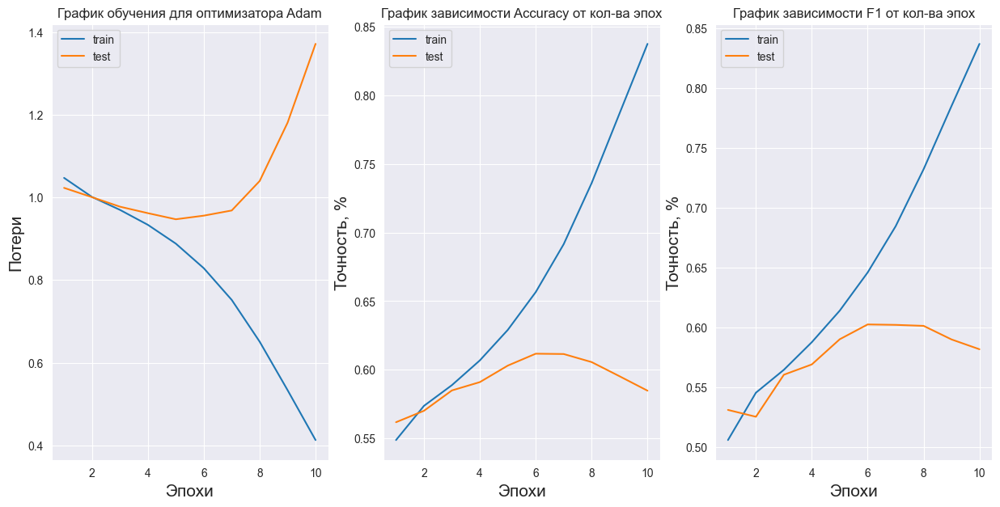

In [76]:
plt.figure(figsize=(15, 7))
plt.subplot(1, 3, 1)
plt.plot(range(1, e + 1), trls, label="train")
plt.plot(range(1, e + 1), tsls, label="test")
plt.xlabel("Эпохи", fontsize=15)
plt.ylabel("Потери", fontsize=15)
plt.title("График обучения для оптимизатора Adam")
plt.legend()
plt.subplot(1, 3, 2)
plt.plot(range(1, e + 1), tra, label="train")
plt.plot(range(1, e + 1), tsa, label="test")
plt.xlabel("Эпохи", fontsize=15)
plt.ylabel("Точность, %", fontsize=15)
plt.legend()
plt.title("График зависимости Accuracy от кол-ва эпох")
plt.subplot(1, 3, 3)
plt.plot(range(1, e + 1), trf1, label="train")
plt.plot(range(1, e + 1), tsf1, label="test")
plt.xlabel("Эпохи", fontsize=15)
plt.ylabel("Точность, %", fontsize=15)
plt.legend()
plt.title("График зависимости F1 от кол-ва эпох")
plt.grid
plt.show()

In [81]:
X = train_features[train_features.columns.drop(['label', 'audio_path', 'dataset'])]
y = pd.DataFrame(train_features[train_features.columns[-2]])
X = preprocessing.StandardScaler().fit(X).transform(X)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.28, random_state=123)


dic = {'neutral': 0, 'sad': 1, 'positive': 2, 'angry': 3, 'other': 4}
y_train = y_train['label'].map(dic)
y_train.dropna(inplace=True)
y_test = y_test['label'].map(dic)
y_test.dropna(inplace=True)
y_train = y_train.to_numpy()
y_test = y_test.to_numpy()
# Convert the data to PyTorch tensors
X_train = torch.from_numpy(X_train).float()
X_test = torch.from_numpy(X_test).float()
y_train = torch.from_numpy(y_train).long()
y_test = torch.from_numpy(y_test).long()
# Create a PyTorch dataset and dataloader
dataset_train = TensorDataset(X_train, y_train)
dataloader_train = DataLoader(dataset_train, batch_size=128, shuffle=True)
dataset_test = TensorDataset(X_test, y_test)
dataloader_test = DataLoader(dataset_test, batch_size=128, shuffle=True)

In [85]:
class VariableHiddenDimBiLSTM(nn.Module):
    def __init__(self, input_dim, hidden_dims, output_dim):
        super(VariableHiddenDimBiLSTM, self).__init__()
        self.num_layers = len(hidden_dims)
        self.lstm_layers = nn.ModuleList()

        self.lstm_layers.append(nn.LSTM(input_dim, hidden_dims[0], bidirectional=True))

        for i in range(1, self.num_layers):
            self.lstm_layers.append(nn.LSTM(hidden_dims[i-1]*2, hidden_dims[i], bidirectional=True))

        self.fc = nn.Linear(hidden_dims[-1]*2, output_dim)  # Output dimension will be doubled due to bidirectional LSTM
        self.hidden_dims = hidden_dims

    def init_hidden(self, bs):
        hidden = []
        for i in range(self.num_layers):
            hidden.append((torch.zeros(2, bs, self.hidden_dims[i]), torch.zeros(2, bs, self.hidden_dims[i])))  # Doubled hidden state dimension for bidirectional LSTM
        return hidden

    def forward(self, X, hidden):
        out = X.unsqueeze(0)
        for i in range(self.num_layers):
            out, hidden[i] = self.lstm_layers[i](out, hidden[i])
            out = out[0] + out[1]  # Combine forward and backward outputs
        out = out.squeeze(0)
        out = torch.log_softmax(self.fc(out), dim=1)
        return out, hidden

# Create an instance of the SVM model
model = VariableHiddenDimLSTM(input_dim=45, hidden_dims=[4096, 2048, 1024, 512], output_dim=4)

# Move the model and data to GPU if available

model.to(device)
X_test = X_test.to(device)
loss_function = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

In [86]:
%%time
epochs = 10
trf1 = []
tsf1 =[]
tsa=[]
tra=[]
trls = []
tsls = []
for e in range(1, epochs + 1):
    train_loss = 0
    train_acc = 0
    train_f1 = 0
    model.train()
    for batch in tqdm(dataloader_train, leave=True):
        x, y = batch
        x, y = x.cuda(), y.cuda()

        # Initialize the hidden state for each layer
        hidden = model.init_hidden(x.size(0))
        for i in range(len(hidden)):
            hidden[i] = (hidden[i][0].to(device), hidden[i][1].to(device))

        # Forward pass and backprop
        out, hidden = model(x, hidden)
        loss = loss_function(out, y)
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        train_loss += loss.item()
        train_acc += accuracy(out, y)
        train_f1 += f1_f(out, y)

    # Scale accuracy and losses
    train_loss /= len(dataloader_train)
    train_acc /= len(dataloader_train)
    train_f1 /= len(dataloader_train)

    test_loss = 0
    test_acc = 0
    test_f1 = 0

    with torch.no_grad():
        for batch in tqdm(dataloader_test, leave=True):
            x, y = batch
            x, y = x.cuda(), y.cuda()

            hidden = model.init_hidden(x.size(0))
            for i in range(len(hidden)):
                hidden[i] = (hidden[i][0].to(device), hidden[i][1].to(device))

            out, hidden = model(x, hidden)
            loss = loss_function(out, y)

            test_loss += loss.item()
            test_acc += accuracy(out, y)
            test_f1 += f1_f(out, y)

    test_loss /= len(dataloader_test)
    test_acc /= len(dataloader_test)
    test_f1 /= len(dataloader_test)
    trf1.append(train_f1)
    tsf1.append(test_f1)
    tsa.append(test_acc)
    tra.append(train_acc)
    trls.append(train_loss)
    tsls.append(test_loss)

    print("Epoch {:4} | Train Loss {:.4f} | Train Acc {:.4f} | Train F1 {:.4f} | Test Loss {:.4f} | Test Acc {:.4f} | Test F1 {:.4f}".format(e, train_loss, train_acc, train_f1, test_loss, test_acc, test_f1))

100%|██████████| 348/348 [00:01<00:00, 260.92it/s]


Epoch    1 | Train Loss 1.0507 | Train Acc 0.5477 | Train F1 0.5027 | Test Loss 1.0281 | Test Acc 0.5608 | Test F1 0.5357


100%|██████████| 348/348 [00:01<00:00, 261.15it/s]


Epoch    2 | Train Loss 1.0023 | Train Acc 0.5735 | Train F1 0.5446 | Test Loss 0.9994 | Test Acc 0.5723 | Test F1 0.5372


100%|██████████| 348/348 [00:01<00:00, 262.11it/s]


Epoch    3 | Train Loss 0.9649 | Train Acc 0.5925 | Train F1 0.5687 | Test Loss 0.9720 | Test Acc 0.5870 | Test F1 0.5529


100%|██████████| 348/348 [00:01<00:00, 257.83it/s]


Epoch    4 | Train Loss 0.9223 | Train Acc 0.6135 | Train F1 0.5953 | Test Loss 0.9526 | Test Acc 0.5994 | Test F1 0.5796


100%|██████████| 348/348 [00:01<00:00, 264.54it/s]


Epoch    5 | Train Loss 0.8663 | Train Acc 0.6408 | Train F1 0.6276 | Test Loss 0.9521 | Test Acc 0.6058 | Test F1 0.5886


100%|██████████| 348/348 [00:01<00:00, 258.89it/s]


Epoch    6 | Train Loss 0.7912 | Train Acc 0.6740 | Train F1 0.6654 | Test Loss 0.9604 | Test Acc 0.6097 | Test F1 0.5993


100%|██████████| 348/348 [00:01<00:00, 258.41it/s]


Epoch    7 | Train Loss 0.6908 | Train Acc 0.7182 | Train F1 0.7136 | Test Loss 1.0089 | Test Acc 0.6062 | Test F1 0.5963


100%|██████████| 348/348 [00:01<00:00, 255.67it/s]


Epoch    8 | Train Loss 0.5618 | Train Acc 0.7733 | Train F1 0.7711 | Test Loss 1.1280 | Test Acc 0.5987 | Test F1 0.5884


100%|██████████| 348/348 [00:01<00:00, 266.42it/s]


Epoch    9 | Train Loss 0.4338 | Train Acc 0.8284 | Train F1 0.8274 | Test Loss 1.2778 | Test Acc 0.5886 | Test F1 0.5827


100%|██████████| 348/348 [00:01<00:00, 243.62it/s]

Epoch   10 | Train Loss 0.3179 | Train Acc 0.8759 | Train F1 0.8755 | Test Loss 1.5069 | Test Acc 0.5876 | Test F1 0.5828
CPU times: total: 31min 56s
Wall time: 3min 17s


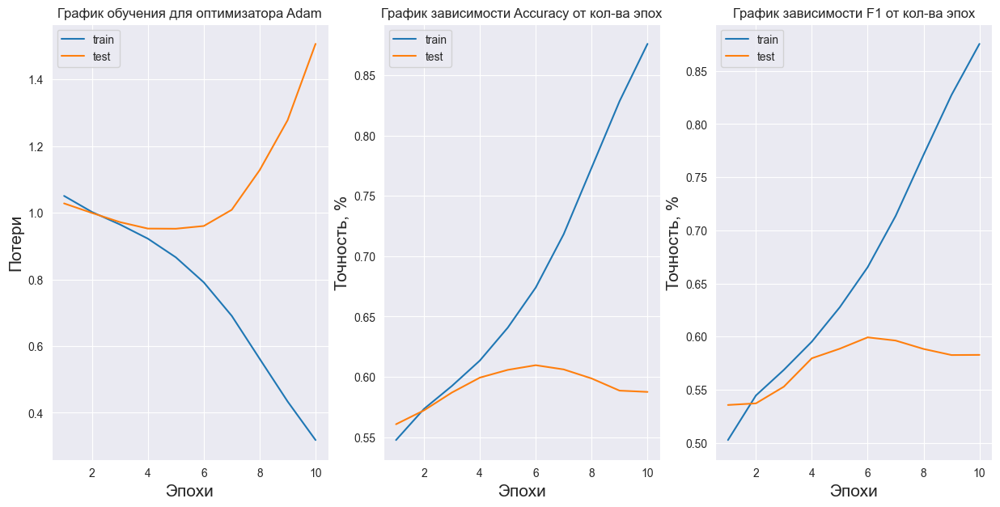

In [88]:
plt.figure(figsize=(15, 7))
plt.subplot(1, 3, 1)
plt.plot(range(1, e + 1), trls, label="train")
plt.plot(range(1, e + 1), tsls, label="test")
plt.xlabel("Эпохи", fontsize=15)
plt.ylabel("Потери", fontsize=15)
plt.title("График обучения для оптимизатора Adam")
plt.legend()
plt.subplot(1, 3, 2)
plt.plot(range(1, e + 1), tra, label="train")
plt.plot(range(1, e + 1), tsa, label="test")
plt.xlabel("Эпохи", fontsize=15)
plt.ylabel("Точность, %", fontsize=15)
plt.legend()
plt.title("График зависимости Accuracy от кол-ва эпох")
plt.subplot(1, 3, 3)
plt.plot(range(1, e + 1), trf1, label="train")
plt.plot(range(1, e + 1), tsf1, label="test")
plt.xlabel("Эпохи", fontsize=15)
plt.ylabel("Точность, %", fontsize=15)
plt.legend()
plt.title("График зависимости F1 от кол-ва эпох")
plt.grid
plt.show()